In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
sns.set()
%matplotlib inline
%config InlineBackend.figure_format = 'svg'

<h2> Курсовая работа по курсу: <br> Библиотеки Python для Data Science: Numpy, Matplotlib, Scikit-learn  </h2>
<h3> на тему: Прогнозирование цены на недвижимость (Real Estate Price Prediction)</h3>

<h2> Описание набора данных</h2>
<p> Ваша задача этом соревновании - предсказать цены на квартиры в датасете test.csv. Вам будут даны два датасета: train.csv (содержит признаки и цены на квартиры) и test.csv (только признаки).</p>
<h3> <a href = "https://www.kaggle.com/c/real-estate-price-prediction-moscow/overview/description"> 
Ссылка на оригинальный датасет (kaggle.com)</a>
</h3>

# 1. Загрука и очистка данных

<h3 id = "part1"> 1. Загрузка и очистка данных</h2>

In [3]:
# Ссылки на файлы набора данных (файлы скопированы в git проекта курсовой)
train_data_link = 'https://raw.githubusercontent.com/Segrey372017/gb_data_science_python_libs/main/train.csv'
test_data_link = 'https://raw.githubusercontent.com/Segrey372017/gb_data_science_python_libs/main/test.csv'
valid_data_link = 'https://raw.githubusercontent.com/Segrey372017/gb_data_science_python_libs/main/sample_submission.csv'

In [4]:
# Загрузка тренировочного набора
train_data = pd.read_csv(train_data_link)
train_data.head()  # первые пять строк набора данных

,Id,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,Price
0,11809,27,3.0,115.027311,NaN,10.0,4,10.0,2014,0.075424,B,B,11,3097,0,NaN,0,0,B,305018.871089
1,3013,22,1.0,39.832524,23.169223,8.0,7,8.0,1966,0.118537,B,B,30,6207,1,1183.0,1,0,B,177734.553407
2,8215,1,3.0,78.342215,47.671972,10.0,2,17.0,1988,0.025609,B,B,33,5261,0,240.0,3,1,B,282078.720850
3,2352,1,1.0,40.409907,NaN,1.0,10,22.0,1977,0.007122,B,B,1,264,0,NaN,0,1,B,168106.007630
4,13866,94,2.0,64.285067,38.562517,9.0,16,16.0,1972,0.282798,B,B,33,8667,2,NaN,0,6,B,343995.102962


In [5]:
#общие сведения о наборе данных
train_data.info

<bound method DataFrame.info of          Id  DistrictId  Rooms  ...  Shops_1  Shops_2          Price
0     11809          27    3.0  ...        0        B  305018.871089
1      3013          22    1.0  ...        0        B  177734.553407
2      8215           1    3.0  ...        1        B  282078.720850
3      2352           1    1.0  ...        1        B  168106.007630
4     13866          94    2.0  ...        6        B  343995.102962
...     ...         ...    ...  ...      ...      ...            ...
9995   1260          61    2.0  ...        9        B  119367.455796
9996  16265          27    2.0  ...        0        A  199715.148807
9997   2795         178    1.0  ...        5        B  165953.912580
9998  14561          21    1.0  ...        5        B  171842.411855
9999   7202          94    1.0  ...        9        B  177685.627486

[10000 rows x 20 columns]>

In [6]:
#вернем исходный индекс (индексацию по полю Id)
train_data.index = train_data['Id']
train_data.pop('Id') # удаляем столбец, дублирующий индекс
#train_data.head()

Id
11809    11809
3013      3013
8215      8215
2352      2352
13866    13866
         ...  
1260      1260
16265    16265
2795      2795
14561    14561
7202      7202
Name: Id, Length: 10000, dtype: int64

In [7]:
cols = train_data.columns.values # Сохраним массив с названиями колонок
cols

array(['DistrictId', 'Rooms', 'Square', 'LifeSquare', 'KitchenSquare',
       'Floor', 'HouseFloor', 'HouseYear', 'Ecology_1', 'Ecology_2',
       'Ecology_3', 'Social_1', 'Social_2', 'Social_3', 'Healthcare_1',
       'Helthcare_2', 'Shops_1', 'Shops_2', 'Price'], dtype=object)

In [8]:
#Обработка пропущенных значений
missing = train_data.isna()

In [9]:
missing.mean() * 100 # определим долю пропущенных данных в каждом столбце

DistrictId        0.00
Rooms             0.00
Square            0.00
LifeSquare       21.13
KitchenSquare     0.00
Floor             0.00
HouseFloor        0.00
HouseYear         0.00
Ecology_1         0.00
Ecology_2         0.00
Ecology_3         0.00
Social_1          0.00
Social_2          0.00
Social_3          0.00
Healthcare_1     47.98
Helthcare_2       0.00
Shops_1           0.00
Shops_2           0.00
Price             0.00
dtype: float64

<h3> Выводы: </h3>
<p> В оновном поля набора данных заполнены без пропусков за исключением полей "LifeSquare"(жилая площадь), "Healthcare"(Медицинкская помощь).<br>
Столбец "Жилая площадь" (LifeSquare) заполнен "более аккуратно" в нем пропущены лишь 21% данных. В столбце "Медицинская помощь" (Healthcare) пропущено 48 % данных. <br> 
Таким образом, если "в лоб" удалить все строки с пропусками, то будет потяряна критическая часть данных для обучения. Нкобходимо рассмотреть возможность либо отказаться от признаков "LifeSquare" и "HealthSqure" или как-то заместить пропущенные данные. 
</p>

In [10]:
# рассмотрим признак "LifeSquare", возможно он имеет тесную связь с какими-либо признаками набора данных возможно со "Square"
square = pd.DataFrame(train_data) # перенесем площади в отдельный датафрем
square = square.dropna()  # удалим все промуски
square.shape

(4457, 19)

In [11]:
square.corr()

,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Price
DistrictId,1.000000,0.079951,0.008879,-0.006038,0.017500,-0.070974,-0.125187,0.014287,-0.177728,0.066347,-0.019429,0.165304,0.269740,0.255102,0.154611,0.218437
Rooms,0.079951,1.000000,0.654066,0.499406,0.000934,-0.018023,-0.033844,-0.017256,-0.068122,-0.006895,0.004773,0.027607,0.030604,0.012238,0.026759,0.541623
Square,0.008879,0.654066,1.000000,0.801915,0.021984,0.162126,0.190612,-0.012432,-0.043617,-0.082406,-0.047188,0.083818,-0.036315,-0.017420,0.063943,0.548151
LifeSquare,-0.006038,0.499406,0.801915,1.000000,0.004518,0.112529,0.108736,-0.011017,-0.016576,-0.077227,-0.044268,0.115757,-0.026867,-0.019178,0.087367,0.362663
KitchenSquare,0.017500,0.000934,0.021984,0.004518,1.000000,0.012512,0.009542,0.000733,-0.024404,0.011244,0.005005,-0.018499,-0.004243,0.041773,-0.001429,0.020392
Floor,-0.070974,-0.018023,0.162126,0.112529,0.012512,1.000000,0.511717,0.003539,-0.010333,-0.072622,-0.054609,-0.027229,-0.124697,-0.094608,-0.011603,0.153121
HouseFloor,-0.125187,-0.033844,0.190612,0.108736,0.009542,0.511717,1.000000,-0.000193,-0.013989,-0.052703,-0.019161,-0.031241,-0.142837,-0.121282,-0.007615,0.170941
HouseYear,0.014287,-0.017256,-0.012432,-0.011017,0.000733,0.003539,-0.000193,1.000000,-0.000192,0.000055,-0.000123,-0.000400,-0.013326,0.009850,0.003669,0.003039
Ecology_1,-0.177728,-0.068122,-0.043617,-0.016576,-0.024404,-0.010333,-0.013989,-0.000192,1.000000,-0.241728,-0.288790,-0.185880,-0.016162,-0.104295,-0.171502,-0.183366
Social_1,0.066347,-0.006895,-0.082406,-0.077227,0.011244,-0.072622,-0.052703,0.000055,-0.241728,1.000000,0.911615,-0.100404,0.014472,0.265933,0.239878,0.000554


<h3> Выводы </h3>
<p> Действительно признак жилая площадь показал высокую корреляцию с полем Общая площадь и число комнат (Square, Rooms) 0,8 и 0,5 
соответствено с остальными признаками коорреляция слабая </p>

In [12]:
# ОБработаем пропуски в столбце-признаке "LifeSquare"
# Создадим новый пизнак "lifeSquare_NA"
train_data['LifeSquare_NA'] = 1 * train_data['LifeSquare'].isna() # соответственно где пропуски будут 1, где значения 0
train_data['LifeSquare_NA'].astype('int')
train_data[['Square','LifeSquare', 'LifeSquare_NA']]


,Square,LifeSquare,LifeSquare_NA
Id,,,
11809,115.027311,NaN,1
3013,39.832524,23.169223,0
8215,78.342215,47.671972,0
2352,40.409907,NaN,1
13866,64.285067,38.562517,0
...,...,...,...
1260,49.090728,33.272626,0
16265,64.307684,37.038420,0
2795,29.648057,16.555363,0


In [13]:
# Воспользуемся очевидной связью признаков "Square" и "LifeSquare" заполним пропученные значения линейной регрессией 
# от признака Square, для обучения модели набор данных очищенный от пропусков

from sklearn.linear_model import LinearRegression

sq_reg = LinearRegression(fit_intercept = False) # установив влаг чтобы не вычислят пересечения с осью Y, логично 
                                                # поскольку если ощая площадь квартиры равна нулю, то и жилая равна 0

In [14]:
# обучим модель на данных без пропусков, ожидаем что коэффиент при переменной должент быть больше 0 но меньше 1 
sq_reg.fit(X = square['Square'].values.reshape(-1,1), y = square['LifeSquare'])
print(sq_reg.coef_)

[0.65917823]


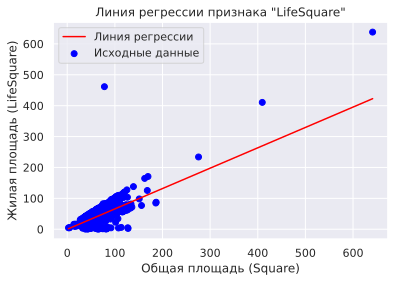

In [15]:
# выведем графики исходных данных и линии регрессии
xcord = np.linspace(square.Square.min(), square.Square.max(), 1000)
plt.figure(figsize= (6,4))
plt.scatter(square.Square, square.LifeSquare, c = 'blue', label = 'Исходные данные')
plt.plot(xcord, sq_reg.predict(xcord.reshape(-1,1)), c = 'red', label = 'Линия регрессии')
plt.title('Линия регрессии признака "LifeSquare"')
plt.xlabel('Общая площадь (Square)')
plt.ylabel('Жилая площадь (LifeSquare)')
plt.legend(loc = 'best')
plt.show()

In [16]:
# Восппользуемся полученной моделью регрессии для заполнения пропущенных значений 
X_square = train_data['Square'].loc[train_data.LifeSquare_NA == 1] # готовим признаки для пропущенных значений
ls_reg = sq_reg.predict(X_square.values.reshape(-1,1))

train_data.LifeSquare.loc[X_square.index] = pd.Series(data = ls_reg, index= X_square.index)

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [17]:
# проверим заполнение
train_data.isna().mean()*100

DistrictId        0.00
Rooms             0.00
Square            0.00
LifeSquare        0.00
KitchenSquare     0.00
Floor             0.00
HouseFloor        0.00
HouseYear         0.00
Ecology_1         0.00
Ecology_2         0.00
Ecology_3         0.00
Social_1          0.00
Social_2          0.00
Social_3          0.00
Healthcare_1     47.98
Helthcare_2       0.00
Shops_1           0.00
Shops_2           0.00
Price             0.00
LifeSquare_NA     0.00
dtype: float64

In [18]:
train_data.head(20)

,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,Price,LifeSquare_NA
Id,,,,,,,,,,,,,,,,,,,,
11809,27,3.0,115.027311,75.823499,10.0,4,10.0,2014,0.075424,B,B,11,3097,0,NaN,0,0,B,305018.871089,1
3013,22,1.0,39.832524,23.169223,8.0,7,8.0,1966,0.118537,B,B,30,6207,1,1183.0,1,0,B,177734.553407,0
8215,1,3.0,78.342215,47.671972,10.0,2,17.0,1988,0.025609,B,B,33,5261,0,240.0,3,1,B,282078.720850,0
2352,1,1.0,40.409907,26.637331,1.0,10,22.0,1977,0.007122,B,B,1,264,0,NaN,0,1,B,168106.007630,1
13866,94,2.0,64.285067,38.562517,9.0,16,16.0,1972,0.282798,B,B,33,8667,2,NaN,0,6,B,343995.102962,0
5804,99,3.0,62.528465,47.103833,6.0,9,9.0,1972,0.012339,B,B,35,5776,1,2078.0,2,4,B,161044.944138,0
8864,44,1.0,33.938750,21.772930,9.0,1,12.0,1968,0.232205,B,B,24,4860,1,80.0,0,3,B,142402.739272,0
13072,59,2.0,50.391814,32.893256,8.0,8,17.0,1986,0.019509,B,B,37,7687,11,176.0,5,5,B,326174.175191,0
9951,1,1.0,46.887892,44.628132,1.0,12,20.0,1977,0.007122,B,B,1,264,0,NaN,0,1,B,160400.401732,0


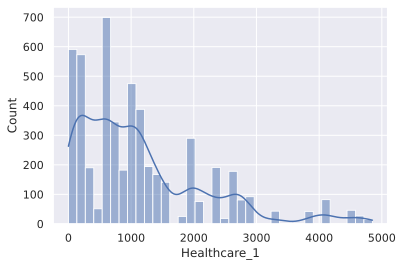

In [19]:
# Рассмтрим признак  Healthcare_1 в нем заполнено только 48% значений
# Описания признака нет, данные описаны вещественным числом
sns.histplot(data = train_data.Healthcare_1, kde= True)


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


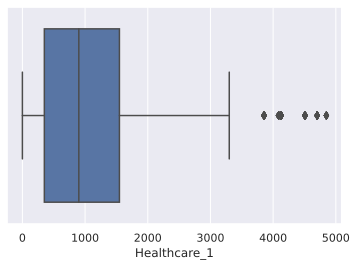

In [20]:
sns.boxplot(train_data.Healthcare_1, whis= 1.5)

In [21]:
# описательная статистика признака
train_data.Healthcare_1.describe()

count    5202.000000
mean     1142.904460
std      1021.517264
min         0.000000
25%       350.000000
50%       900.000000
75%      1548.000000
max      4849.000000
Name: Healthcare_1, dtype: float64

<p>Среднее значение состаляет 1142,9, гистограмма и боксплот значительное отклонение данных от нормального распределения 
 ("толстый и длинный правый хвост гистограммы, несиметричные "усы" бокс плота). Исходя из наименования признака минимального значения 0 и максимального 4849, возможно в данном признаке указано расстояние до ближайшего объекта здравоохранения (возможно расмотрены объекты в шаговой доступности - 1 час пешком, что дает радиус от 0 до 5000 м). <br> 
 В наборе данных инфраструктура здравоохранения описана двумя признаками "Healthcare_1", Helthcare_2. Признаки слабокоррелированы (коэффицент окло 0,18) постром парный график, возможно ест межу признаками нелинейные зависимости<p>

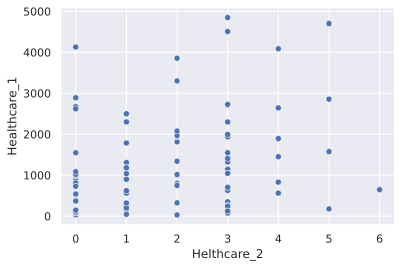

In [22]:
sns.scatterplot(data= square, x = 'Helthcare_2', y = 'Healthcare_1') # график по выборке данных очищенных от пропусков

<p> Похоже если по признаку Healthcare_1 дано расстояние до объекта здравоохранения. То признак "Helthcare_2" отражает качественный уровень оценки объекта здравоохранения оп бальной шкале. Абсолютное большинство объектов здравохранения имеют бальную оценку в диапазоне от 0 до 5, один объект имеет оценку 6 баллов (возможно опечатка). 
Каких-то очевидных связей между бальной оценкой и расстоянием до объекта не имеется. Оценку в 0 баллов имеют объекты как расположенные в пределах 0, так и удаленные свыше 4000, аналогично оценку в 5 баллов есть у объекта в пределах 500, так и на удаленнии свыше 4500. <br>
Таким образом, обработаем пропуски по признаку Healthcare_1 заполнением медианными значениями, исключить признак на данном этапе не целесообразно поскольку имеющиеся данные могут оказаться важными для построения моделей.
<p>

In [23]:
# создадим новый сигнальный признак 'Healthcare_1_NA'
train_data['Healthcare_1_NA'] = 1 * train_data['Healthcare_1'].isna() # соответственно где пропуски будут 1, где значения 0
train_data['Healthcare_1_NA'].astype('int')
train_data[['Healthcare_1', 'Healthcare_1_NA']]

,Healthcare_1,Healthcare_1_NA
Id,,
11809,NaN,1
3013,1183.0,0
8215,240.0,0
2352,NaN,1
13866,NaN,1
...,...,...
1260,NaN,1
16265,NaN,1
2795,NaN,1


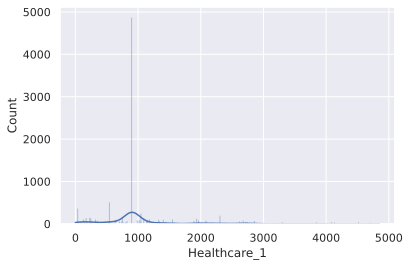

In [24]:
# заменяем пропуски данных на медианные значения
train_data.Healthcare_1 = train_data.Healthcare_1.fillna(value = train_data.Healthcare_1.median())
sns.histplot(data = train_data.Healthcare_1, kde= True)

In [25]:
# Такой подход привел к переизбытку значений равных медианному. Попробуем обработать пропуски другим образом.
# Заполним пропущенные значения случайными числами, нормально распределенными со значениями  стреднего и стандартного отклонения 
# имеющейся выборки
rnd = np.random.RandomState(42) # воспроизводимый генератор случайных чисел
train_data.Healthcare_1.loc[train_data.Healthcare_1_NA == 1] = np.abs(rnd.normal(loc = 1142.904460, # матожидание (среднее значение)
                                                 scale = 1021.517264, # стандартное отклонение
                                                 size = train_data.Healthcare_1_NA.sum())) # количество пропусков

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


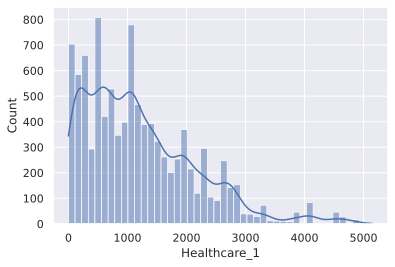

In [26]:
# Снова построим гистограмму распределения
sns.histplot(data = train_data.Healthcare_1, kde= True)

<p> Такой способ заполнения позволил привести распределение признаков ближе к форме нормального, и сохранить в датасете подлинные данные для обучения модели </p>

<h3> 2. Приведение типов данных, обрабока категориальных признаков</h3>

# 2. Приведение типов данных, обработка категориальных признаков

In [27]:
# Датасете ряд признков хоть и закодированы числовыми значениями, являются дискретными (категориальными признаками)
# один из таким признаков "DistrictId" (Номер района), рассмотримм описательную статистику признака
train_data.DistrictId.describe()

count    10000.000000
mean        50.400800
std         43.587592
min          0.000000
25%         20.000000
50%         36.000000
75%         75.000000
max        209.000000
Name: DistrictId, dtype: float64

<p> Минимальное значение равно 0, максимальное 209. Таким образом, признак образует 210 категорий. Возможно районы ранжированы по уровню цен на недвижиость. Проверим эту гипотезу построив парный график.

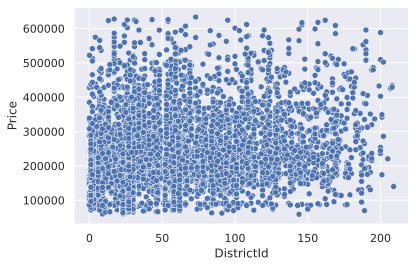

In [28]:
sns.scatterplot(data = train_data, x = 'DistrictId', y = 'Price')

<p> График показывает отсутсвие взаимосвязи между номером района (DistrictId) и стоимостью недвижимости. Скорее всего для разбиениея по районам использовано текущее административно-территориальное деление, или устойчивые традиционные наименования районов города </p>

In [29]:
# Подготовим значения категорий для признака
cat =  [str(i) for i in range(210)]
# Втроенный в Pandsas метод get_dummies не подойдет поскольку в набор данных содержится в разных файлайх и процесс векторизации 
# признаков подет в них независимо, что внесест путаницу в данные

In [30]:
# Воспользуемся специальным кодировщиком из sklearn
from sklearn.preprocessing import label_binarize

In [31]:
#Трасформируем признак в строковые значения

train_data.DistrictId = train_data.DistrictId.astype('str')
train_data.DistrictId

Id
11809     27
3013      22
8215       1
2352       1
13866     94
        ... 
1260      61
16265     27
2795     178
14561     21
7202      94
Name: DistrictId, Length: 10000, dtype: object

In [32]:
district = label_binarize(train_data.DistrictId, classes= cat)
district.shape

(10000, 210)

In [33]:
# Такое преобразование образовало набор сильно разреженных признаков. Применим к нему метод обучения без учителя 
#- алгоритм понижения размерности isomap. Проекцию многомерного пространства в заданную размерность

from sklearn.manifold import Isomap
iso = Isomap(n_components= 1)

In [34]:
district_iso = iso.fit_transform(district)

In [35]:
district_iso = pd.Series(data = district_iso[:,0], index = train_data.DistrictId.index)

In [36]:
district_iso.head()

Id
11809   -0.226796
3013     4.809478
8215     0.089100
2352     0.089100
13866    1.536597
dtype: float64

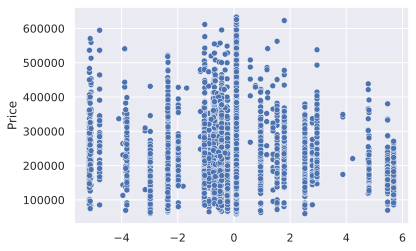

In [37]:
# Снова построим парный график цены и метки района
sns.scatterplot(x= district_iso.values, y = train_data.Price)

In [38]:
# Применение векторизации и понижения размерности позволило выявить определенную структуру в данных, будем надеется
# такое преобразование не привело к потере существенной информации для машинного обучения
train_data['District_iso'] = district_iso
train_data.head(5)

,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,Price,LifeSquare_NA,Healthcare_1_NA,District_iso
Id,,,,,,,,,,,,,,,,,,,,,,
11809,27,3.0,115.027311,75.823499,10.0,4,10.0,2014,0.075424,B,B,11,3097,0,1650.306543,0,0,B,305018.871089,1,1,-0.226796
3013,22,1.0,39.832524,23.169223,8.0,7,8.0,1966,0.118537,B,B,30,6207,1,1183.000000,1,0,B,177734.553407,0,0,4.809478
8215,1,3.0,78.342215,47.671972,10.0,2,17.0,1988,0.025609,B,B,33,5261,0,240.000000,3,1,B,282078.720850,0,0,0.089100
2352,1,1.0,40.409907,26.637331,1.0,10,22.0,1977,0.007122,B,B,1,264,0,1001.665089,0,1,B,168106.007630,1,1,0.089100
13866,94,2.0,64.285067,38.562517,9.0,16,16.0,1972,0.282798,B,B,33,8667,2,1804.529483,0,6,B,343995.102962,0,1,1.536597


In [39]:
# Следующий признак Ecology_2 наоборот представлен строковыми значениями 
train_data.Ecology_2.value_counts()

B    9903
A      97
Name: Ecology_2, dtype: int64

In [40]:
# Признак Ecology_3 также содаержит категориальные признаки
train_data.Ecology_3.value_counts()

B    9725
A     275
Name: Ecology_3, dtype: int64

In [41]:
#Целесообразно  этим категориям присвоить числовые метки для каждого класса
#использует также кодировщих из sklearn
from sklearn.preprocessing import LabelEncoder
l_coder = LabelEncoder()
train_data.Ecology_2 = l_coder.fit_transform(train_data.Ecology_2)
train_data.Ecology_3 = l_coder.fit_transform(train_data.Ecology_3)
train_data.Shops_2 = l_coder.fit_transform(train_data.Shops_2)

In [42]:
train_data.head(5)

,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,Price,LifeSquare_NA,Healthcare_1_NA,District_iso
Id,,,,,,,,,,,,,,,,,,,,,,
11809,27,3.0,115.027311,75.823499,10.0,4,10.0,2014,0.075424,1,1,11,3097,0,1650.306543,0,0,1,305018.871089,1,1,-0.226796
3013,22,1.0,39.832524,23.169223,8.0,7,8.0,1966,0.118537,1,1,30,6207,1,1183.000000,1,0,1,177734.553407,0,0,4.809478
8215,1,3.0,78.342215,47.671972,10.0,2,17.0,1988,0.025609,1,1,33,5261,0,240.000000,3,1,1,282078.720850,0,0,0.089100
2352,1,1.0,40.409907,26.637331,1.0,10,22.0,1977,0.007122,1,1,1,264,0,1001.665089,0,1,1,168106.007630,1,1,0.089100
13866,94,2.0,64.285067,38.562517,9.0,16,16.0,1972,0.282798,1,1,33,8667,2,1804.529483,0,6,1,343995.102962,0,1,1.536597


<h3> Добавление дополнительных признаков</h3>
<p> Введем дополнительные признаки, которые вычисляются из имеющихся, и дадут дополнительные характеристики рынка недвижимости с точки зрения покупателей/продавцов:
<ol> 
<li> Отметка 0 или 1 для объектов расположенных на первом этаже дома </li>
<li> Отметка 0 или 1 для объектов расположенных на последнем этаже дома </li>
<li> Отметка 0 или 1 для объектов площадь кухни котрых больше медианного значения (большая кухня)</li>
</ol>
</p>

## Добавление дополнительных признаков

In [43]:
# Квартиры, расположенные на первых и последних этажах как правило стоят дешевле, а таже соответветственно менее предпочтительны
# для покупателей
train_data['First_floor'] = pd.Series(data = np.zeros(10000), index = train_data.index)
train_data['First_floor'].loc[train_data.Floor == 1] = 1

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [44]:
# Аналогично признак для последнего этажа
train_data['Last_floor'] = pd.Series(data = np.zeros(10000), index = train_data.index)
train_data['Last_floor'].loc[train_data.Floor == train_data.HouseFloor] = 1

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [45]:
# Площадь кухни больше среднего (Большая кухня). Большие кухни выглядят более предпочтительно и как правило располагаются в более современных и комфотных домах. 
# Плюс позволяет разместить больше современной бытовой техники
mean_kitch = train_data.KitchenSquare.mean()
train_data['Large_kitchen'] = pd.Series(data = np.zeros(10000), index = train_data.index)
train_data['Large_kitchen'].loc[train_data.KitchenSquare > mean_kitch] = 1

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [46]:
train_data.head(5)

,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,Price,LifeSquare_NA,Healthcare_1_NA,District_iso,First_floor,Last_floor,Large_kitchen
Id,,,,,,,,,,,,,,,,,,,,,,,,,
11809,27,3.0,115.027311,75.823499,10.0,4,10.0,2014,0.075424,1,1,11,3097,0,1650.306543,0,0,1,305018.871089,1,1,-0.226796,0.0,0.0,1.0
3013,22,1.0,39.832524,23.169223,8.0,7,8.0,1966,0.118537,1,1,30,6207,1,1183.000000,1,0,1,177734.553407,0,0,4.809478,0.0,0.0,1.0
8215,1,3.0,78.342215,47.671972,10.0,2,17.0,1988,0.025609,1,1,33,5261,0,240.000000,3,1,1,282078.720850,0,0,0.089100,0.0,0.0,1.0
2352,1,1.0,40.409907,26.637331,1.0,10,22.0,1977,0.007122,1,1,1,264,0,1001.665089,0,1,1,168106.007630,1,1,0.089100,0.0,0.0,0.0
13866,94,2.0,64.285067,38.562517,9.0,16,16.0,1972,0.282798,1,1,33,8667,2,1804.529483,0,6,1,343995.102962,0,1,1.536597,0.0,1.0,1.0


# 3. Разведочный анализ данных (EDA)

In [47]:
# Подготовим функции для ряда рутинных операций (отрисовка графиков, подсчет стандартных статистических величин и т.п.)

def draw_gist(data, title):
    """ Строит гистограмму распределения величины data посредством seaborn"""
    sns.histplot(data = data, kde= True)
    plt.title(title)
    return

def draw_boxplot(data, title, whis = 1.5):
    """ Строит Боксплот для величины data, параметр интерквантильного интервала 
    whis = 1.5 
    """
    sns.boxplot(data, whis= 1.5)
    plt.title(title)
    return

def draw_scatter(x_data, y_data, title):
    """ Cтроит точечную диаграмму для определения взимосвязи между аргументом 
    x_data и зависимой величиной y_data
    """
    sns.scatterplot(x_data, y_data)
    plt.title(title)
    return

def anova_test(x_data, y_data, alpha = 0.05):
    """ Расчет дисперсионного анализа для количественной величины y_data
    влияния качественной величины x_data,
    расчет проводится для доверительного интервала 0,95% (alpha = 0.05)
    """
    from scipy.stats import norm, t  # значения t статистики и нормального расределения
    from scipy.stats import f  # Значения критерия Фишера
    from scipy.stats import f_oneway # однофакторный дисперсионных анализ
   
    cat = x_data.value_counts().index.values
    print(cat)
    k = len(cat) # числок категорий (степени свободы числителя)
    n = x_data.count() # количество значений
    print(f'Количество категорий к = {k}, Количество значений n = {n}')
    f_cr = f.ppf(1-alpha, k-1, n-k)  # Критическое значение критерия фишера
    
    feat = dict()
    for cat_i in cat:
        feat[cat_i] = list(y_data.values[x_data.values == cat_i]) # отбираем значения количественного показателя, находящиеся в соответствующей группе
    
    # print('Словарь групп', feat.values())
    f_args = list(feat.values()) # получаем список массивов со группированными ценами
    st, p_val = f_oneway(*f_args) # передаем указатель на список массивов

    res = ''
    if st > f_cr :
        res = f""" Значение расчетного критерия {st} больше критического {f_cr}, следовательно в группах по 
              данному категориальному признаку есть значимые отличия (p-value {p_val}) """
    else: 
        res = f""" Значение расчетного критерия {st} меньше критического {f_cr}, следовательно в группах  по 
              данному категориальному признаку не имеется статистически значимых отличий (p-value {p_val})"""

    return print(res)

def trust_interval(data, alpha = 0.05):
    """ Оценивает значение для доверительного интервала средней величины.
    """
    from scipy.stats import norm, t  # значения t статистики и нормального расределения

    ta = 1-alpha/2 # квантиль t распределения
    m = np.mean(data.values)
    n = len(data.values)
    T = t.ppf(ta,n-1) * np.std(data.values)/n**0.5 # граница интервала
    return f"Матожидание генеральной совокупности c вероятностью {(1-alpha)*100}% находится в интервале от  {m-T} до {m+T}"
    

In [48]:
# разделение набора данных на количественные и качественные признаки
num_cols = [ 'Rooms', 'Square', 'LifeSquare', 'KitchenSquare',
       'Floor', 'HouseFloor', 'HouseYear', 'Ecology_1', 'Social_1', 'Social_2', 'Social_3','Healthcare_1', 'Helthcare_2',
       'Shops_1', 'District_iso']
cat_cols = ['DistrictId',  'Ecology_2', 'Ecology_3', 'Shops_2', 'LifeSquare_NA',
       'Healthcare_1_NA',  'First_floor', 'Last_floor', 'Large_kitchen']


## 3.1. Анализ количественных признаков

### Rooms - Количество комнат

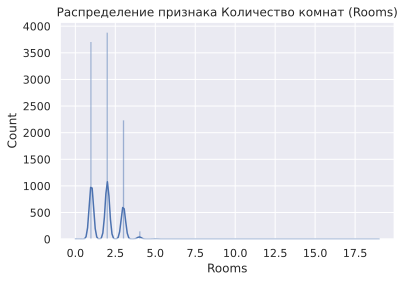

In [49]:
# Первый признак 'Rooms' - количество комнат
draw_gist(train_data[num_cols[0]], "Распределение признака Количество комнат (Rooms)")

In [50]:
# Описательная статистика 'Rooms'
train_data[num_cols[0]].describe()

count    10000.000000
mean         1.890500
std          0.839512
min          0.000000
25%          1.000000
50%          2.000000
75%          2.000000
max         19.000000
Name: Rooms, dtype: float64

In [51]:
# Выведем наиболее часто встречающееся количетво комнат
train_data[num_cols[0]].value_counts()

2.0     3880
1.0     3705
3.0     2235
4.0      150
5.0       18
0.0        8
10.0       2
19.0       1
6.0        1
Name: Rooms, dtype: int64

<p> Наиболее часто встречающиеся квартиры двухкомнатные, затем однокомнатные  и трехкомнатные, соответствующие пики видны на гистограмме распределения. У распределения имются "тяжелые хвосты" так как имеются 10-ти и 19-комнатные квартиры. При этом 75% квартир 1 или 2 комнатные. При этом 8 квартир имеют 0 комнат, что скорее всего являетс ошибкой ввода</p>

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


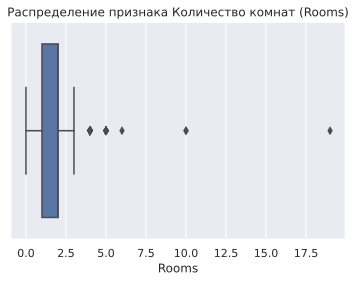

In [52]:
# Коробчатая диаграмма для признака Rooms
draw_boxplot(train_data[num_cols[0]], "Распределение признака Количество комнат (Rooms)")

<p> Соответственно квартиры с количеством комнат превышающим 3 обозначились на диаграмее как выбросы </p>

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


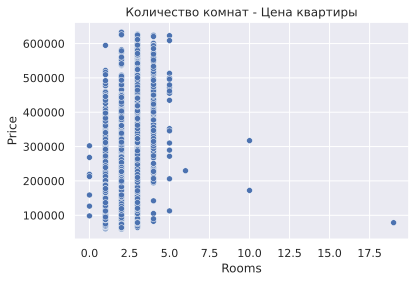

In [53]:
# Построим точечную диаграмму влияния признака Количество комант на цену квартиры
draw_scatter(train_data[num_cols[0]], train_data['Price'], "Количество комнат - Цена квартиры")

<p> Точечная диаграмма показывает слабую корреляцию между количеством комнат и ценой квартры. Практически "дорогие" и "дешевые" квартиры встречаются в групах и с малым количеством комнат и с большим. Парадоксально, но квартира с количеством комнат 19 и 10 одни из самых дешевых. </p>

In [54]:
# Выполним преобразование данных в признаке
train_data[num_cols[0]].values[train_data[num_cols[0]] == 0] = 1.0 # заменим количество комнат равное 0 на 1-комнатные
train_data[num_cols[0]].values[train_data[num_cols[0]] >= 10.0] = train_data['Rooms'].median() # 10 и 19 комнатные квартиры скорее ошибки ввода заменим медианными значениями

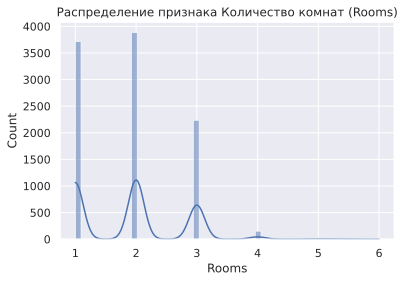

In [55]:
draw_gist(train_data[num_cols[0]], "Распределение признака Количество комнат (Rooms)")

In [56]:
# вычислим коэффициент корреляции 'Rooms' 'Price'
train_data[['Rooms', 'Price']].corr()

,Rooms,Price
Rooms,1.000000,0.570864
Price,0.570864,1.000000


<p> Расчет коэффициента подтвердил слабое положительное влияние увеличения количества комнат на стоимость квартиры </p>

### Square - Общая площадь

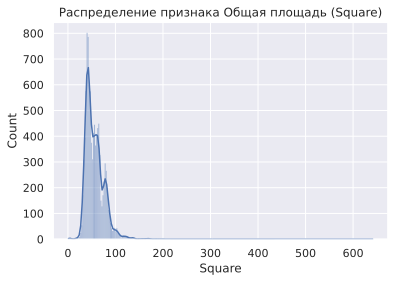

In [57]:
# Следующий признак Общая площадь (Square)
# Его диаграмма распределения
draw_gist(train_data[num_cols[1]], "Распределение признака Общая площадь (Square)")

<p> Характер распределения признака имеет близко к нормальному. В свою очередь есть нессколько пиков на наиболее часто встречающихся площадях (скорее всего типовое жилье). В отличе от предыдущего признака данный признак является непрерывным. </p>

In [58]:
train_data[num_cols[1]].describe()

count    10000.000000
mean        56.315775
std         21.058732
min          1.136859
25%         41.774881
50%         52.513310
75%         65.900625
max        641.065193
Name: Square, dtype: float64

<p> Среднее значение 56,31 кв.м. близко к медианному - следовательно значительные выбросы отсутствуют. Также как и у предыдующего признака имеются "тяжелый" правый хвост - встречается небольшое чило квартир очень большой площади, что характерно для реальных данных </p>

In [59]:
train_data[num_cols[1]].value_counts(bins = 10)

(0.496, 65.13]        7350
(65.13, 129.123]      2596
(129.123, 193.115]      47
(193.115, 257.108]       3
(577.072, 641.065]       2
(385.094, 449.087]       1
(257.108, 321.101]       1
(513.08, 577.072]        0
(449.087, 513.08]        0
(321.101, 385.094]       0
Name: Square, dtype: int64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


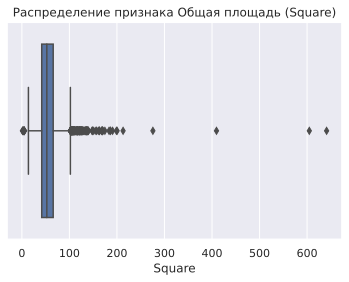

In [60]:
# Коробчатая диаграмма для признака Square
draw_boxplot(train_data[num_cols[1]], "Распределение признака Общая площадь (Square)")

<p> На коробчатой диаграмме квартиры площадью свыше 100 кв.м. показаны как выборосы. При этом имеются выбросы слева - квартиры экстремально малой площади. Как и экстремально "большие"  так и "маленкие" квартиры имеют право на существование в реальности учитывая что для г. Москва характерно наличие застройки разных эпох. </p>

In [61]:
small_flat = train_data['Square'].quantile(0.0035) # вычисляем площадь квартир на границу левого уса боксплота
print(small_flat)

25.449416941111032


In [62]:
# Проанализируем количество экстремально маленьких квартир (0.35% квантиль) - выбросы слева
small_flats = train_data['Square'].loc[train_data.Square.values <= train_data.Square.quantile(0.0035)]
print(small_flats)


Id
6782      2.954309
1098     23.015919
828      20.924926
4504      4.390331
16202    22.072457
3732     20.213128
12079    25.410513
10940    24.749737
9487      5.129222
9905     22.691542
14642    22.682706
15877    16.547242
11292    24.711701
2915     23.891837
15744     1.988943
7657      4.502784
11526     4.633498
1775     23.583220
6927     16.117154
6351     20.606762
13685    17.498542
1748      5.497061
14236    19.927423
14786     1.136859
13299    24.769705
523      18.509177
12927    17.414181
10202     2.596351
10527     4.380726
13265     4.823679
12676    13.784865
15127    17.046188
10476    21.121279
3224      2.377248
10635    18.983962
Name: Square, dtype: float64


In [63]:
small_flats.describe()

count    35.000000
mean     14.876719
std       8.638041
min       1.136859
25%       4.728589
50%      17.498542
75%      22.377581
max      25.410513
Name: Square, dtype: float64

<p> Как видим в зону выбросов попали 35 квартир, средней площадью 14.9 кв. м. при этом площадь минимальной квартиры всего 1,1 кв. м. При этом в зону выбросов попали квартиры вполне адекватно площади - менее 25.44 кв.м. - что соответствует площади однокомнатной квартиры советской застройки </p>

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


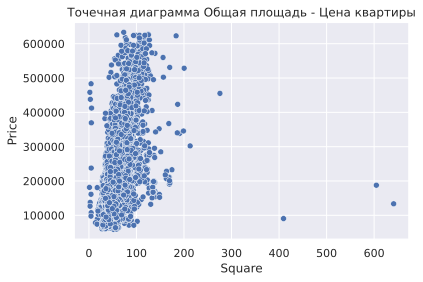

In [64]:
# Проанализируем влияние площади квартиры на её стоимость. Очевидно ожидается прямая положительная корреляция
draw_scatter(x_data = train_data[num_cols[1]], y_data = train_data['Price'], title = 'Точечная диаграмма Общая площадь - Цена квартиры')

<p> Действительно есть определенная положительная связь - цем выше площадь тем выше цена квартиры. Но точечная диаграмма свидетельствует что площадь не определяющий фактор. Например есть квартиры площадью около 100 кв.м. стоимостью до 100 000 и стоимостью более 600 000. Примечательно что в "отрыве" оказались квартиры площадью свыше 400м и аномально низкой ценой до 200 000. Среди экстремально малых квартир имеются и "дешевые" до 100 000 и относительно "дорогие" свыше 400 000. Таким образом, на цену квартиры сильное влияние оказывают иные факторы кроме общей площади</p>

In [65]:
# На сонове точечной диаграммы заменим площади квартир свыше 150м медианными значениям для устранения влияния выбросов
train_data['Square'].iloc[train_data.Square >= 150.0] = train_data.Square.median()

# Для устранения влияния выбросов слева, также заменим экстремально малые площади квартир медианными значниями
train_data['Square'].iloc[train_data.Square <= small_flat] = train_data.Square.median()

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


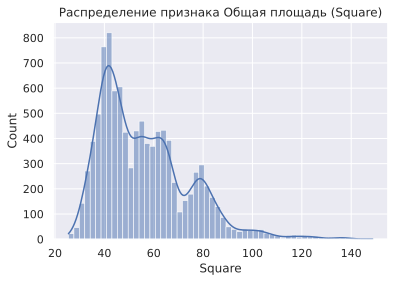

In [66]:
# Построим снова гистограмму распределения признака Square
draw_gist(train_data[num_cols[1]], "Распределение признака Общая площадь (Square)")

In [67]:
# вычислим коэффицент корреляции
train_data[['Square','Price']].corr()

,Square,Price
Square,1.000000,0.589361
Price,0.589361,1.000000


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


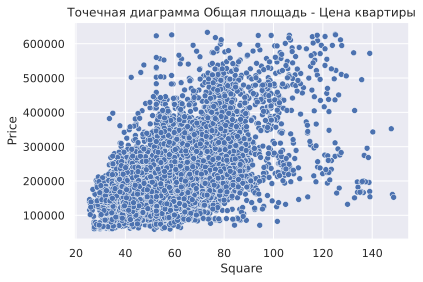

In [68]:
# Действительно наблюдается слабая (до 60%) положительная корреляция. Точечная диаграмма с преобразованными данными
draw_scatter(x_data = train_data[num_cols[1]], y_data = train_data['Price'], title = 'Точечная диаграмма Общая площадь - Цена квартиры')

<p> Действительно, после обработки выбросов прямая связ между Общей площадью и ценой квартиры стала более наглядной </p>

### LifeSquare - Жилая площадь

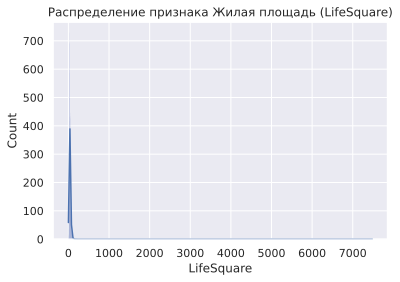

In [69]:
# Проанализируем следующий признак LifeSquare
draw_gist(train_data[num_cols[2]], "Распределение признака Жилая площадь (LifeSquare)")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


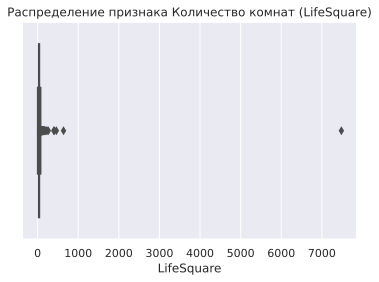

In [70]:
# Гистограмма показывает значтельное количество выбросов - тяжелый правый хвост. Построим коробчатую диаграмму
draw_boxplot(train_data[num_cols[2]], "Распределение признака Количество комнат (LifeSquare)")

<p> Коробчатая диаграмма показывает наличен аномальный данных - квартиры с жилой площадью свыше 7000 кв.м. Наличе таких аномалий сильно искажает данные </p>

In [71]:
# Выведем площади кварир, оказавшихся за пределами правой границы выбросов
large_flat = train_data.LifeSquare.quantile(1-0.0035)
print(large_flat)

113.11217605118011


In [72]:
# Определим количество и статистические характеристики квартир из зоны выбросов
large_flats = train_data.LifeSquare.loc[train_data.LifeSquare >= large_flat]
large_flats

Id
2737      125.806981
6006      122.497641
14990     263.542020
3627      118.048978
28        398.609010
14181     153.685835
4811      113.830425
10417     120.795231
8901      114.913843
3267      138.004600
16568     201.627361
5548      233.949309
98        120.968324
5621      161.504222
7616      125.650178
10043     118.986655
15886     461.463614
11055     174.837082
716       127.477137
8961      164.153360
6674      125.486563
15362     161.155275
542       138.910187
2603      164.526757
2307      410.639749
7917      211.231125
500       117.446940
10322     125.306808
16550    7480.592129
12570     136.697187
5300      170.713651
11602     638.163193
4249      123.139863
12638     136.215499
12142     115.110477
Name: LifeSquare, dtype: float64

In [73]:
# описательная статистика выбросов
large_flats.describe()

count      35.000000
mean      394.733920
std      1238.451396
min       113.830425
25%       122.818752
50%       138.004600
75%       188.232221
max      7480.592129
Name: LifeSquare, dtype: float64

<p> Расчеты показали, что наибольшее влияние оказывает один экземлпря данных - квартила жилой площадью 7480 кв.м. При этом площадь оставшихся 35 квартир не превышает 138 кв.м. Для устранения влияния выбросов можно воспользоватся ранее полученным соотношением между общей площадью квартиры Square и жилой площадью. Применив коэффициент 0.65917823  </p>

In [74]:
# Для иллюстрации выведем соответствующие значения параметров Square и LifeSquare
train_data[['Square','LifeSquare']].loc[large_flats.index]

,Square,LifeSquare
Id,,
2737,123.430072,125.806981
6006,121.844004,122.497641
14990,48.449873,263.542020
3627,120.771217,118.048978
28,52.513310,398.609010
14181,52.513310,153.685835
4811,110.075277,113.830425
10417,117.870532,120.795231
8901,121.577423,114.913843


In [75]:
# Здравый смысл подсказывает, что размер жилой площади не должен превосходить размер общей площади. Для данных, попавших в выбросы это условие практически не выполяняется
# Проведем пересчет соответствующих значений жилой площади согласно имеющемуся соотношению 0,65918
train_data.LifeSquare.loc[large_flats.index] = train_data.Square.loc[large_flats.index] * 0.65917823

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


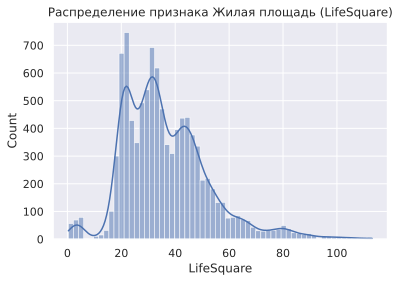

In [76]:
# Снова вернемся к построению гистограммы распределения признака LifeSquare после устранения аномалий
draw_gist(train_data[num_cols[2]], "Распределение признака Жилая площадь (LifeSquare)")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


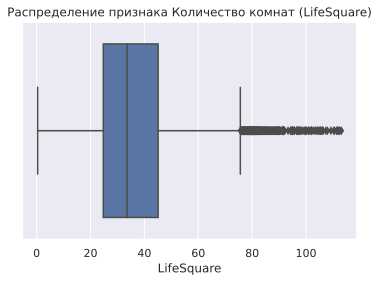

In [77]:
# Теперь распределение признака стало более соответствовать нормальноу распределению и распределению признака Square
draw_boxplot(train_data[num_cols[2]], "Распределение признака Количество комнат (LifeSquare)")

In [78]:
# Поскольку признаки Square и LifeSquare взаимосвязаны, необходимо обеспечить их согласованность Square > LifeSquarе, выберем данные которые этому условию противоречат
squares = train_data.LifeSquare.loc[train_data.LifeSquare >= train_data.Square]
squares

Id
847      74.131261
3992     87.730225
11771    39.624493
13343    82.931595
13875    32.514021
           ...    
16258    98.152802
14175    44.682167
2201     41.984322
11665    64.602939
9289     88.931509
Name: LifeSquare, Length: 465, dtype: float64

In [79]:
# таких оказалось 465 экземлпяров, на данное количество также оказали влияние манипуляции с признаком Square проведенные выше
# Приведем данные в соответствие применив известный коэффициент
train_data.LifeSquare.loc[squares.index] = train_data.Square.loc[squares.index] * 0.65917823

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


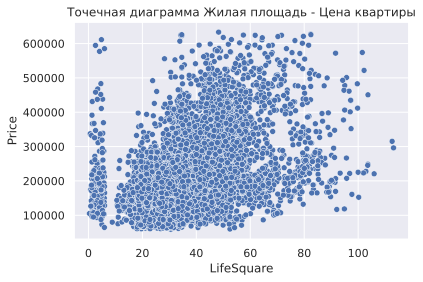

In [80]:
# Теперь можно изучить влияние признака на целевой признак Price. Построим точечную диаграмму
draw_scatter(x_data = train_data[num_cols[2]], y_data = train_data['Price'], title = 'Точечная диаграмма Жилая площадь - Цена квартиры')

In [81]:
# вычислим коэффициент корреляции
train_data[['LifeSquare','Price']].corr()

,LifeSquare,Price
LifeSquare,1.000000,0.447142
Price,0.447142,1.000000


<p> Аналогично предыдушему признаку, признак LifeSquare показал слабую положительную корреляцию с целевым признаком Price </p>

In [82]:
# удалим переменные, котоыре больше не требуются для освобождения памяти
del large_flat, large_flats
del small_flat, small_flats
del squares

### KitchenSquare - Площадь кухни

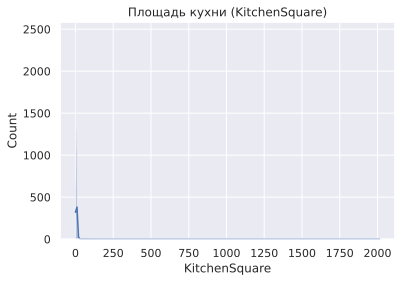

In [83]:
# Перейдем к признаку Площадь кухни (KitchenSquare)
draw_gist(train_data[num_cols[3]], "Площадь кухни (KitchenSquare)")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


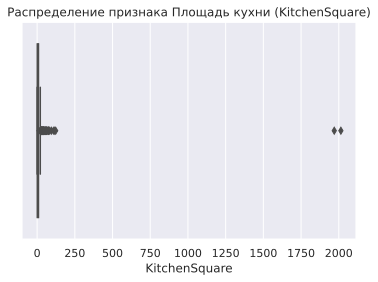

In [84]:
# Коробчатая диаграмма для Kitchen Square
draw_boxplot(train_data[num_cols[3]], "Распределение признака Площадь кухни (KitchenSquare)")

<p> Построенные даиаграммы свидетельствуют о наличии значительных выбросов, которые сильно искажают распределение данных. Как и у предыдующих признаков, связанных с площдадью квартир имеются тяжелые хвосты справа (аномально большие значения) </p>

In [85]:
# описательная статистика для признака KitchenSquare
train_data.KitchenSquare.describe()

count    10000.000000
mean         6.273300
std         28.560917
min          0.000000
25%          1.000000
50%          6.000000
75%          9.000000
max       2014.000000
Name: KitchenSquare, dtype: float64

In [86]:
# определим количество экземпляров данных, попавших в зону выбросов
l_kitchen = train_data.KitchenSquare.quantile(1-0.0035) # граница выбросов
print(l_kitchen)

31.003500000000713


In [87]:
l_kitchens = train_data.KitchenSquare.loc[train_data.KitchenSquare > l_kitchen]
l_kitchens

Id
2737      123.0
10546      43.0
16593      62.0
15781      35.0
3267       43.0
16395      72.0
2271       40.0
7111       42.0
12390      96.0
300        32.0
1315       48.0
6569       84.0
12507      78.0
6708       39.0
2371       66.0
12918      51.0
299        60.0
4966       75.0
15466      41.0
7441      112.0
16781      36.0
13703      73.0
11739      58.0
11624      37.0
6508       63.0
448        41.0
673        51.0
14679    1970.0
4265       53.0
12666      58.0
12552     112.0
3233       32.0
7162       54.0
9690       37.0
14656    2014.0
Name: KitchenSquare, dtype: float64

In [88]:
# описательная статистика выбросов
l_kitchens.describe()

count      35.000000
mean      169.457143
std       455.868166
min        32.000000
25%        41.000000
50%        54.000000
75%        74.000000
max      2014.000000
Name: KitchenSquare, dtype: float64

<p> Наибольшее влияние на распределение признака оказывают экземлпря данных в которых площадь кухни более 1000 кв.м. Соответственно для устарения влияния выбросов заменим аномальные данные медианным значениями. Как и при анализе предыдущих признаков даких данных всего 35 экземпляров </p>

In [89]:
# замена выбросов медианными значениями
train_data.KitchenSquare.loc[l_kitchens.index] = train_data.KitchenSquare.median()

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [90]:
# Как и в случае предущих признаков, связанных с площадью необходимо обеспечить их согласованность. 
# В данном случае должно выдерживатся соотношение Square > (LifeSquare + KitchenSquare).
# Т.е. сумма жилой площади и площади кухни должна быть меньше общей площади
# определим экземпляры данных не походящих под данное условие
incorrects = train_data.KitchenSquare.loc[train_data.Square <= train_data.KitchenSquare + train_data.LifeSquare]
incorrects

Id
7757     11.0
8576      5.0
12307     8.0
16429     8.0
13616    10.0
         ... 
671      10.0
1509     12.0
12152     9.0
15375     9.0
6149     20.0
Name: KitchenSquare, Length: 356, dtype: float64

In [91]:
# Определим для данных экземпляров данных новые значения KitchenSquare. Путем вычитания из общей площади (Square) жилой площади LifeSquare
# Пусть данный подход не совсем корректен, но он позволит согласовать признаки
train_data.KitchenSquare.loc[incorrects.index] = train_data.Square.loc[incorrects.index] - train_data.LifeSquare.loc[incorrects.index]

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [92]:
# При вычитании могли возникнуть отрицательные значения площадей. Проверим их отсутствие
pd.value_counts(train_data.KitchenSquare.loc[incorrects.index] < 0)

False    356
Name: KitchenSquare, dtype: int64

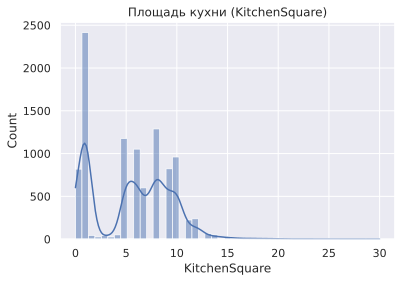

In [93]:
# Соответственно отрицательных значений не найдено. Признаки согласованы
# Теперь можно построить диаграмму распределения очищенного признака
draw_gist(train_data[num_cols[3]], "Площадь кухни (KitchenSquare)")

In [94]:
# Описательная статистика по очищенным данным
train_data.KitchenSquare.describe()

count    10000.000000
mean         5.529143
std          3.912386
min          0.000000
25%          1.000000
50%          6.000000
75%          8.000000
max         30.000000
Name: KitchenSquare, dtype: float64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


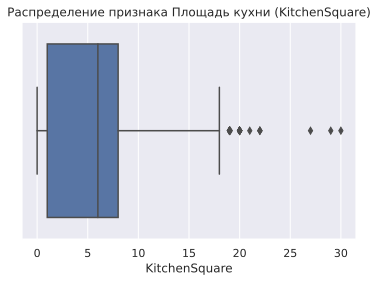

In [95]:
# Боксплот для признака KitchenSquare
draw_boxplot(train_data[num_cols[3]], "Распределение признака Площадь кухни (KitchenSquare)")

<p> Устранение экстремально больших значений и операции по обеспечению согласованности признаков привели к некотому снижению среднего значения площади кухни с 6.27 м до 5.52 м. при незименном медианном значении. Распределение площади по данному признаку имеет значительное смещение в левую часть - наиболее часто встречаются кухни размером меньше медианного. При этом выбросы с левой части отсутстввуют</p>

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


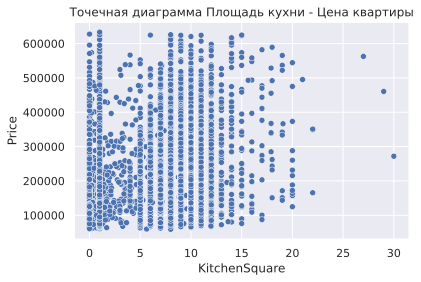

In [96]:
# Построим точечную диаграмму влияния признака KitchenSquare на цену квартиры (Price)
draw_scatter(x_data = train_data[num_cols[3]], y_data = train_data['Price'], title = 'Точечная диаграмма Площадь кухни - Цена квартиры')

In [97]:
# коэффициент корреляции
train_data[['KitchenSquare','Price']].corr()

,KitchenSquare,Price
KitchenSquare,1.000000,0.319359
Price,0.319359,1.000000


<p> Признак KitchenSquare оказывает очень слабую положительную кореляцию с ценой квартиры. Как и в других исследованных признаков квартиры разной стоимости присутствуют практически равновмерно в группах с большой площадью кухни так и с экстремально малой площадью</p>

### Floor - Этаж квартиры

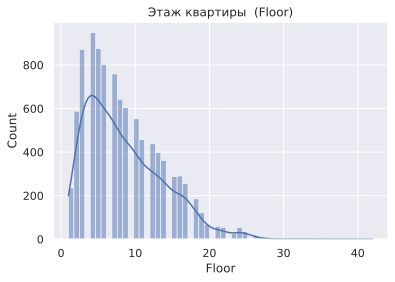

In [98]:
# Проанализируем признак "Этаж квартиры" (Floor). Данный признак дискретный
draw_gist(train_data[num_cols[4]], "Этаж квартиры  (Floor)")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


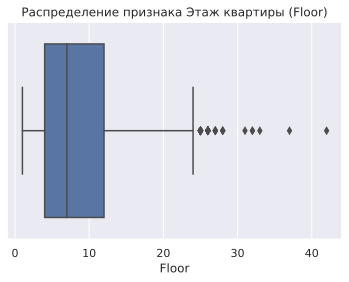

In [99]:
# Коробчатая диаграмма признака Floor
draw_boxplot(train_data[num_cols[4]], "Распределение признака Этаж квартиры (Floor)")

In [100]:
# Описательная статистика признака Floor
train_data.Floor.describe()

count    10000.000000
mean         8.526700
std          5.241148
min          1.000000
25%          4.000000
50%          7.000000
75%         12.000000
max         42.000000
Name: Floor, dtype: float64

<p> В целом данный признак имеет рспределение близкое к нормальному(Логнормальному). Значительное влияиние выбросо не наблюдается - медианное значение  7.0 довольно близкое к среднему 8.52. Тем не менее распределение также имеет "толстый хвост справа". В зону выбросов попали 9 квартир, расположенные выше 25 этажа. Проанализируем данные выбросы подробнее  </p>

In [101]:
# Определеим границу зоны выбросов справа
h_floor = train_data.Floor.quantile(1-0.0035)
print(h_floor)

25.0


In [102]:
# Выведем этажи квартир находящихся в зоне выброса
h_floors = train_data[['Floor', 'HouseFloor']].loc[train_data.Floor > h_floor]
h_floors

,Floor,HouseFloor
Id,,
4280,26,1.0
370,27,25.0
6589,31,44.0
11692,28,30.0
15157,26,37.0
3298,32,40.0
9021,26,25.0
8016,33,40.0
1471,27,25.0


In [103]:
h_floors.describe()

,Floor,HouseFloor
count,32.000000,32.000000
mean,27.937500,24.187500
std,3.680266,13.152793
min,26.000000,0.000000
25%,26.000000,24.000000
50%,26.000000,25.000000
75%,28.000000,30.500000
max,42.000000,48.000000


<p> Анализ показал, что часть данных, оказавшихся в зоне выбросов не являются искаженными и соответсвуют этажности дома (Floor <= HouseFloor). По оставшимся экземплярам провдем манипуляции по обесечению согласованности с признаком HouseFloor</p>

In [104]:
h_floors.Floor.loc[h_floors.Floor > h_floors.HouseFloor] = h_floors.HouseFloor
h_floors['Val_Flag'] = h_floors.Floor <= h_floors.HouseFloor
h_floors

,Floor,HouseFloor,Val_Flag
Id,,,
4280,1.0,1.0,True
370,25.0,25.0,True
6589,31.0,44.0,True
11692,28.0,30.0,True
15157,26.0,37.0,True
3298,32.0,40.0,True
9021,25.0,25.0,True
8016,33.0,40.0,True
1471,25.0,25.0,True


In [105]:
# Замент данные в train_data.Floors на скорректированные
train_data.Floor.loc[h_floors.Floor.index] = h_floors.Floor
train_data.Floor.loc[h_floors.Floor.index]

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


Id
4280      1.0
370      25.0
6589     31.0
11692    28.0
15157    26.0
3298     32.0
9021     25.0
8016     33.0
1471     25.0
7838      1.0
5976     25.0
4320     28.0
7657      1.0
15303     1.0
4145     24.0
8582     25.0
1674     42.0
716      24.0
5685     24.0
11625    26.0
8296     37.0
16511    25.0
12744    25.0
11563    32.0
8241     24.0
7162     25.0
10193    24.0
6514     25.0
1636     24.0
13202     1.0
15704    25.0
7862      0.0
Name: Floor, dtype: float64

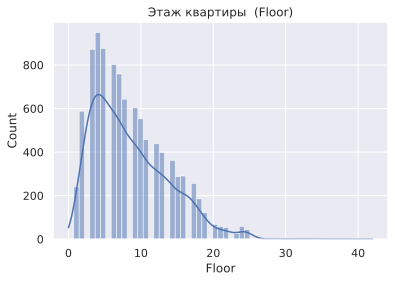

In [106]:
# Выведем скоррекрированну диаграмму рспределения и боксплот
draw_gist(train_data[num_cols[4]], "Этаж квартиры  (Floor)")


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


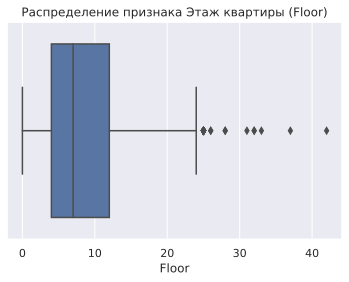

In [107]:
draw_boxplot(train_data[num_cols[4]], "Распределение признака Этаж квартиры (Floor)")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


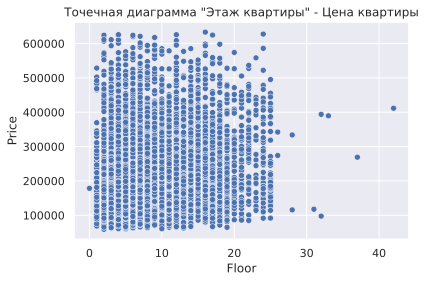

In [108]:
# построим точечную диграмму влияния признка Floor на цену Price
draw_scatter(x_data = train_data[num_cols[4]], y_data = train_data['Price'], title = 'Точечная диаграмма "Этаж квартиры" - Цена квартиры')

In [109]:
# коэффициент корреляции
train_data[['Floor','Price']].corr()

,Floor,Price
Floor,1.000000,0.124228
Price,0.124228,1.000000


<p> Точечная диаграма и коэффициент корреляции показывают крайне слабое положительное влияние этажа расположения квартиры на её цену </p>

### HouseFloor - Этажность дома

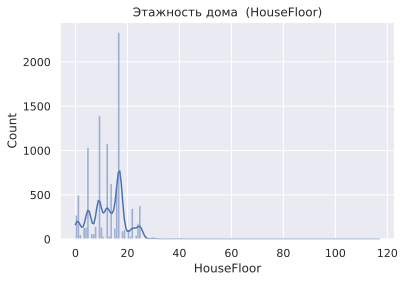

In [110]:
# Проанализируем признак "Этажность домa" (HouseFloor). Данный признак также дискретный 
draw_gist(train_data[num_cols[5]], "Этажность дома  (HouseFloor)")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


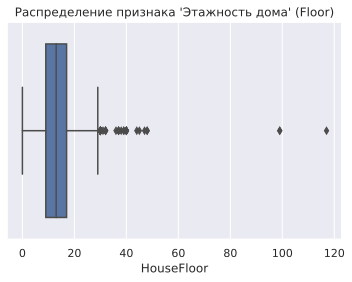

In [111]:
draw_boxplot(train_data[num_cols[5]], "Распределение признака 'Этажность дома' (Floor)")

In [112]:
# Описательная статистика признака Этажность дома (HouseFloor)
train_data[num_cols[5]].describe()

count    10000.000000
mean        12.609400
std          6.775974
min          0.000000
25%          9.000000
50%         13.000000
75%         17.000000
max        117.000000
Name: HouseFloor, dtype: float64

<p> Средняя этажность дома в наборе данных составила 12.6 этажей, что соответствует медианному значению 13 этажей. Распределение признака имеет пики на определенных значения эктажности, что можно объяснить застройкой типового жилья 1,2,3,5,9, 12 этажей. Значения свыше 25 этажей попали в зону выбросов. Распределение имеет два экстремальных выброса - объекты свыше 80 этажей. Анализ предудущего признака показал что максимальной эатаж расположеня квартиры 42. Для снижения влияния выбросов целесообразно заменить значениями в 45 этажей, экземпляры с экстремальной этажностью</p>

In [113]:
train_data.HouseFloor.loc[train_data.HouseFloor > 45] = 45

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [114]:
# Пересчитаем описательную статистику для признака
train_data.HouseFloor.describe()

count    10000.00000
mean        12.59060
std          6.60239
min          0.00000
25%          9.00000
50%         13.00000
75%         17.00000
max         45.00000
Name: HouseFloor, dtype: float64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


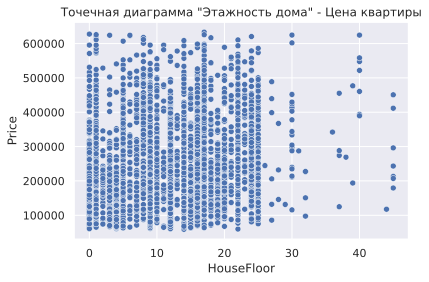

In [115]:
# проанализируем влияние этажности дома на Цену квартиры
draw_scatter(x_data = train_data[num_cols[5]], y_data = train_data['Price'], title = 'Точечная диаграмма "Этажность дома" - Цена квартиры')

In [116]:
train_data[['HouseFloor','Price']].corr()

,HouseFloor,Price
HouseFloor,1.000000,0.089546
Price,0.089546,1.000000


<p> Точечная диаграмма и коэффициент корреляции свидетельствут об отутствии однозначной связи между этажностью дома и ценой квартиры. Действительно 1 или 2-этажным домом может быть как элитный особнях в центральном районе, так и деревянных барак в аварийном состоянии, соответственно и 17 этажных жилой комплекс может быть современным зданием с продуманной планировкой микрорайна и элитным жильем так и панельным  "человейником" в спальном районе без социальной инфраструктуры парковочных мест вдали от станций метро.</p>

### HouseYear - Год постройки

In [117]:
# Проанализируем признак "Год постройки" (HouseYear). Данный признак также дискретный 


In [118]:
train_data.HouseYear.describe()

count    1.000000e+04
mean     3.990166e+03
std      2.005003e+05
min      1.910000e+03
25%      1.974000e+03
50%      1.977000e+03
75%      2.001000e+03
max      2.005201e+07
Name: HouseYear, dtype: float64

In [119]:
# Данный признак также содержит экстремально большие значения. Выведем заведомо некорректные значения
invalid_years = train_data.HouseYear.loc[train_data.HouseYear > 2021]
invalid_years

Id
11607        4968
10814    20052011
Name: HouseYear, dtype: int64

In [120]:
# Действительно обнаружились две ошибки ввода - один экземпляр 11607 скорее всего 4968 опечатка 1968
# Второй экземпляр 10814 опечатка  20052011 примем более поздний год 2011
# исправим некорректные значения
train_data.HouseYear.loc[invalid_years.index] = [1968,2011]

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


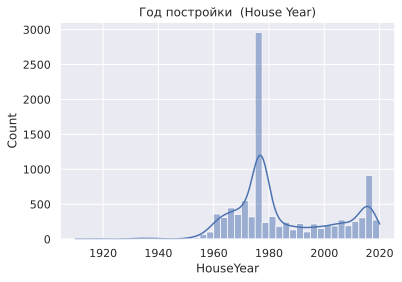

In [121]:
# Выведем гистограмму распределения признака и боксплот
draw_gist(train_data[num_cols[6]], "Год постройки  (House Year)")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


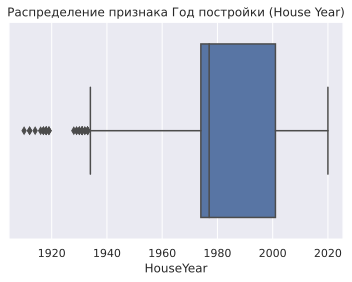

In [122]:
draw_boxplot(train_data[num_cols[6]], "Распределение признака Год постройки (House Year)")

In [123]:
# На гистограмме имеются два наиболее частотных пика - годы массового строительства 
train_data.HouseYear.value_counts().head()

1977    2652
2017     308
2016     305
2015     299
2014     210
Name: HouseYear, dtype: int64

<p> Наибольше количество домов введено на излете "эпохи застоя" перед Олимпиадой 1980 года, следующих пик приходится на 2017 год. Вероятно в 2017 году пришелся пик ввода объектов расположенных в "Новой Москве" присоединенных  в черту города 1 июля 2012 и на разгар эпохи долевого строительства </p>
<p> В зону выбросов попали объекты, построенные до середины 1930 годов</p>

In [124]:
train_data.HouseYear.quantile(0.0035) # верхняя граница выбросов слева

1933.0

<p> Наличие домов ранних лет постройки не является аномальным и вполне согласуется с истоирическим развитием г. Москва. Учитывая что город в течение 20 века пережил несколько волн модернизации перестройки и расширения, дома ранней постройки оказались достаточно редкими. </p>

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


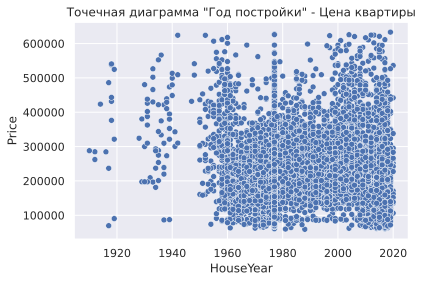

In [125]:
# Проанализируем влияние года постройки (HouseYear) на Цену квартиры (Price)
draw_scatter(x_data = train_data[num_cols[6]], y_data = train_data['Price'], title = 'Точечная диаграмма "Год постройки" - Цена квартиры')

In [126]:
# коэффициент корреляции
train_data[['HouseYear', 'Price']].corr()

,HouseYear,Price
HouseYear,1.000000,0.036634
Price,0.036634,1.000000


<p> Год постройки показывает крайне слабою положительную корреляцию с ценрй квартиры. Хотя точечна диграмма показывает что жилье старше 50 года постройки оказывается в среднем и верхнем ценовом сегменте. В свою очередь жилье послевоенной эпохи и до 1960 года присутствует как и в верхнем ценовом сегменте так и в устра дешевом. В основном жилье построенное в позднюю советскую эпоху и девяностые годы 1970-2000 годы оценивается в среднем и эконом сегменте. Массово жилье премиум класса начинает активно здаваться с начала 2000 года. Скорее всего влияние года постройки на цену жилья носит нелинейный характер, связанный с особенностями застройки города.</p> 

### Ecology_1 - Экология_1

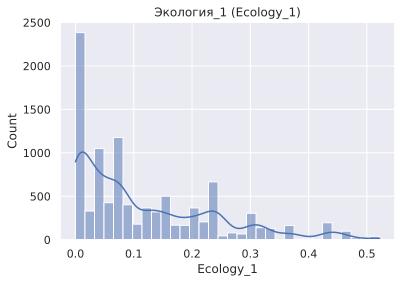

In [127]:
# Перейдем к признаку Ecology_1, который дает определенную количественную оценку экологической обстановки
# Выведем гистограмму распределения признака Экология_1
draw_gist(train_data[num_cols[7]], "Экология_1 (Ecology_1)")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


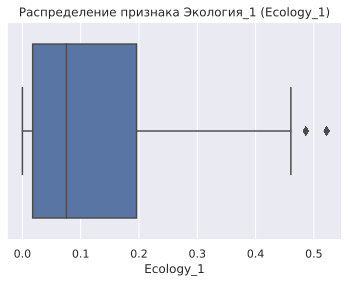

In [128]:
# Боксплот данного признака
draw_boxplot(train_data[num_cols[7]], "Распределение признака Экология_1 (Ecology_1)")

In [129]:
# Описательная статистика
train_data.Ecology_1.describe()

count    10000.000000
mean         0.118858
std          0.119025
min          0.000000
25%          0.017647
50%          0.075424
75%          0.195781
max          0.521867
Name: Ecology_1, dtype: float64

<p> Распределение данного признака имеет распредление отличное от нормального, сильное смещение влево и тяжелый правый хвост. В результате выброса справа, среднее значение больше медианного (смещено вправо). В зону выбросов попало всего два значения превышающих 0.45</p>

In [130]:
# обработае выбросы заменив их медианными значениями
train_data.Ecology_1.loc[train_data.Ecology_1 > train_data.Ecology_1.quantile(1-0.0035)] = train_data.Ecology_1.median()

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


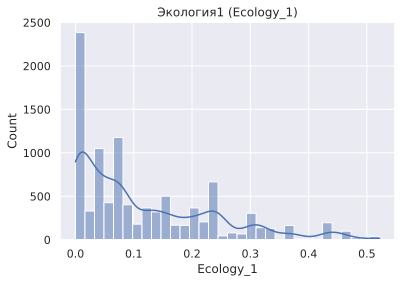

In [131]:
# Построим гистограмму распределения признака с обработанными выбросами
draw_gist(train_data[num_cols[7]], "Экология1 (Ecology_1)")

In [132]:
train_data.Ecology_1.describe() # обработка выбросов практически не повлияла на показатели центра распредления признака

count    10000.000000
mean         0.118858
std          0.119025
min          0.000000
25%          0.017647
50%          0.075424
75%          0.195781
max          0.521867
Name: Ecology_1, dtype: float64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


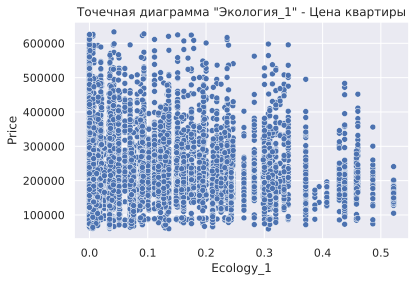

In [133]:
# Проанализируем влияние признака на Цену квартиры
draw_scatter(x_data = train_data[num_cols[7]], y_data = train_data['Price'], title = 'Точечная диаграмма "Экология_1" - Цена квартиры')

In [134]:
# Коэффициент корреляции Ecology_1 и Price
train_data[['Ecology_1','Price']].corr()

,Ecology_1,Price
Ecology_1,1.000000,-0.058381
Price,-0.058381,1.000000


<p> Точечная диаграмма и коэффициент корреляции показывают слабую обратную корреляцию между величинами. Увеличение признака Ecology_1 свидетельствует об ухудьшении экологической ситуации. В свою очередь жилье эконом класса встречается в сегментах с высоким и низким значением признака. Однако жилье среднего и верхнего ценового сегмета практичеси не встречается при достижения показателем величины 0.4. Скорее вего речь также идет о нелинейной зависимости.
</p>

### Social_1 - Социальная инфраструктура_1

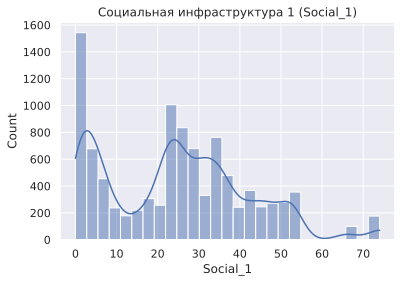

In [135]:
# Проанализируем признак Социальная инфраструктура (Social_1)
draw_gist(train_data[num_cols[8]], "Социальная инфраструктура 1 (Social_1)")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


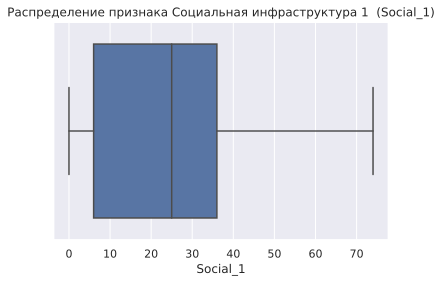

In [136]:
# Коробчатая диаграмма данного признака
draw_boxplot(train_data[num_cols[8]], "Распределение признака Социальная инфраструктура 1  (Social_1)")

In [137]:
# описательная статистика признака Social_1
train_data.Social_1.describe()

count    10000.000000
mean        24.687000
std         17.532614
min          0.000000
25%          6.000000
50%         25.000000
75%         36.000000
max         74.000000
Name: Social_1, dtype: float64

In [138]:
# Наиболее часто встречающиеся значения
train_data.Social_1.value_counts().head(10)

2     688
1     654
25    557
5     528
30    465
23    434
6     377
22    367
53    355
34    311
Name: Social_1, dtype: int64

<p> Распределение данного признака отличается от нормального. В распределении имеется ряд пиков - наиболее частотных значений 2, 25, 34. Экстремально большие и малые значения (выбросы отсутствуют). Поскольку  нет подробной характеристики явления, которое описыавает данный показатель, какие-либо выводы о распределении признака сделать сложно</p>

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


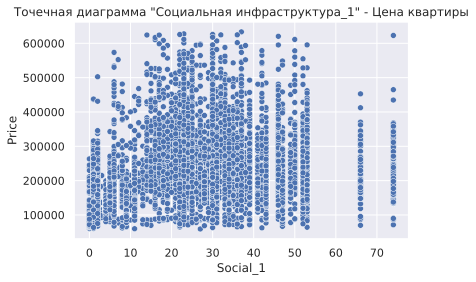

In [139]:
# Проанализируем влияине данного признака на Цену (Price)
draw_scatter(x_data = train_data[num_cols[8]], y_data = train_data['Price'], title = 'Точечная диаграмма "Социальная инфраструктура_1" - Цена квартиры')

In [140]:
# Вычислим коэффициент корреляции
train_data[['Social_1','Price']].corr()

,Social_1,Price
Social_1,1.000000,0.263286
Price,0.263286,1.000000


<p> Коэффициент показывает слабую положительную корреляцию между величинами. В свою очередь явная линейная зависимость отсутстсвует. В свою очередь, в группак со значением признака меньше 10 заметно реже встречаются квартиры среднего и верхнего сегмента. Также квартиры вехнего сегмента не стречаются при значения призкака больше 60 (за исключением одного экзмплеяра </p>

### Social_2 - Социальная инфраструктура 2

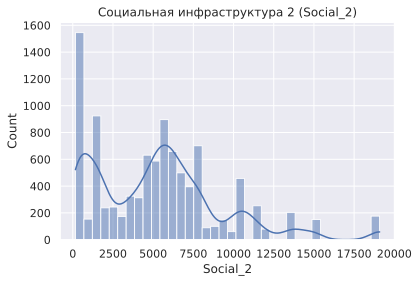

In [141]:
# рассмотрим признак Социальная инфраструктура 2 (Social_2)
draw_gist(train_data[num_cols[9]], "Социальная инфраструктура 2 (Social_2)")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


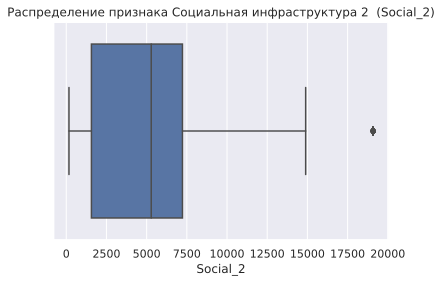

In [142]:
# Боксплот данного признака
draw_boxplot(train_data[num_cols[9]], "Распределение признака Социальная инфраструктура 2  (Social_2)")

In [143]:
# Описательная статистика признака Social
train_data.Social_2.describe()

count    10000.000000
mean      5352.157400
std       4006.799803
min        168.000000
25%       1564.000000
50%       5285.000000
75%       7227.000000
max      19083.000000
Name: Social_2, dtype: float64

In [144]:
# Наиболее частотные значения
train_data.Social_2.value_counts().head(10)

264      587
1564     511
629      486
1437     346
6398     245
13670    204
5648     202
168      190
19083    176
1892     172
Name: Social_2, dtype: int64

<p> По аналогии с предыдущим признаком, распределение также имеет форму отличную от нормального, имеется нескольком пиков на значениях 261, 1564, 6398, 13670. Имеется всего один выброс. Среднее значение расположено довольно близко к медианному, выбросы сильного значения не оказывают</p>

In [145]:
# Обработаем выброс по даному признаку, заменой на медианное значение
train_data.Social_2.loc[train_data.Social_2 > train_data.Social_2.quantile(1-0.0035)] = train_data.Social_2.median()

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


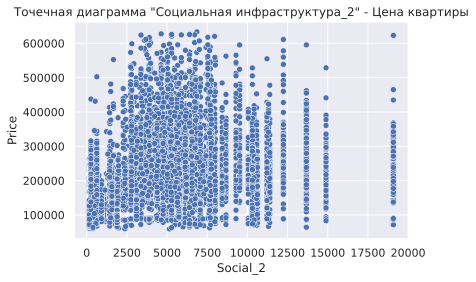

In [146]:
# Рассмотрим влияние признака Social_2 на целевой - Цену квартиры (Price)
draw_scatter(x_data = train_data[num_cols[9]], y_data = train_data['Price'], title = 'Точечная диаграмма "Социальная инфраструктура_2" - Цена квартиры')

In [147]:
# Корреляция признака и целевой величины
train_data[['Social_2','Price']].corr()

,Social_2,Price
Social_2,1.000000,0.239226
Price,0.239226,1.000000


<p> Коэффициент показывает слабую положительную корреляцию между величинами.  В целом наблюдаются такие же закономерности как и в предыдущем признаке. В свою очередь, в группах со значением признака меньше 2000 заметно реже встречаются квартиры среднего и верхнего сегмента. Также квартиры вехнего сегмента реже встречаются  при значения призкака больше 130000. </p>

### Social_3 - Социальная инфраструктура 3

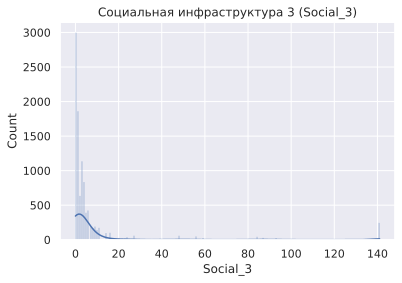

In [148]:
# Рассмотрим признак Социальная инфраструктура_3 (Social_3)
draw_gist(train_data[num_cols[10]], "Социальная инфраструктура 3 (Social_3)")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


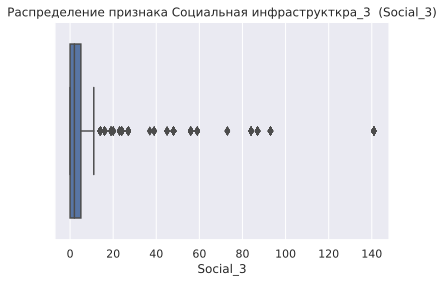

In [149]:
# Боксплот для данного признака
draw_boxplot(train_data[num_cols[10]], "Распределение признака Социальная инфраструкткра_3  (Social_3)")

In [150]:
# Описательная статистия для признка Социальная инфраструктура_3 (Social_3)
train_data.Social_3.describe()

count    10000.000000
mean         8.039200
std         23.831875
min          0.000000
25%          0.000000
50%          2.000000
75%          5.000000
max        141.000000
Name: Social_3, dtype: float64

<p> Диаграммы и расчет по данному признаку показывают наличие значительнго количества выбросов. Выбросы оказали значительное влияние на среднюю величину (смещена вправо) - 8 ед. против медианного значения 2. Обработаем данные выборосы</p>

In [151]:
# определим границу зоны выбросов
social_drop = train_data.Social_3.median()+ 1.5 * (train_data.Social_3.quantile(0.75) - train_data.Social_3.quantile(0.25))
social_drop

9.5

In [152]:
# определим выбросы
social_drops = train_data.Social_3.loc[train_data.Social_3 > social_drop]
social_drops

Id
13072    11
8471     11
3736     14
8576     84
8007     20
         ..
15375    59
14560    11
16557    20
7931     37
2795     14
Name: Social_3, Length: 1176, dtype: int64

In [153]:
# в зону выбросов попали 1176 значений, заменим их на медианные
train_data.Social_3.loc[social_drops.index] = train_data.Social_3.median()

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


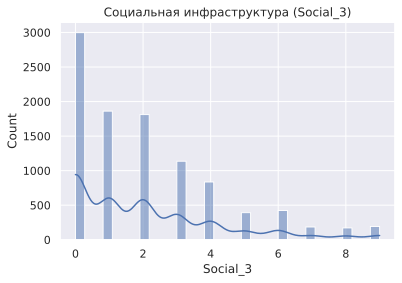

In [154]:
# Выведем гистограмму со скорректированными значениями
draw_gist(train_data[num_cols[10]], "Социальная инфраструктура (Social_3)")

In [155]:
# описательная статистика после корректировки
train_data.Social_3.describe()

count    10000.000000
mean         2.110000
std          2.205082
min          0.000000
25%          0.000000
50%          2.000000
75%          3.000000
max          9.000000
Name: Social_3, dtype: float64

<p> Форма распределения признка теперь приобрела форму логномармального распредееления. Показатели центра распределения приобрели близкие значения</p>

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


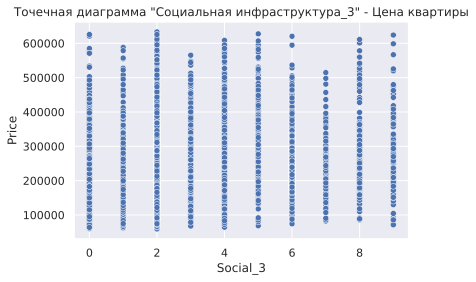

In [156]:
# проанализируем влияние признака на целевой параметр Цена квартиры (Price)
draw_scatter(x_data = train_data[num_cols[10]], y_data = train_data['Price'], title = 'Точечная диаграмма "Социальная инфраструктура_3" - Цена квартиры')

In [157]:
# Коэффициент корреляции
train_data[['Social_3', 'Price']].corr()

,Social_3,Price
Social_3,1.000000,0.254747
Price,0.254747,1.000000


<p> Между данным признаком и целевой величиной имеется слабая положительная корреляция. Влияние признака скорее всего носит нелинейный характер. Например на ряде значений 1, 3, 7 отсутствуют объекты верхнего ценового сегмента</p>

### Healthcare_1 - Здравоохранение_1

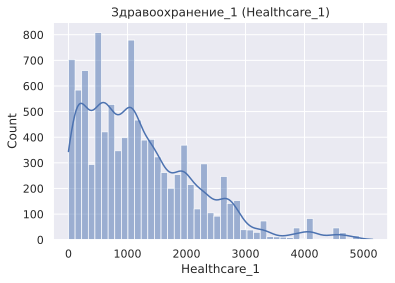

In [158]:
# Рассмотрим признак  Здравоохранение_1 Healthcare_1
draw_gist(train_data[num_cols[11]], "Здравоохранение_1 (Healthcare_1)")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


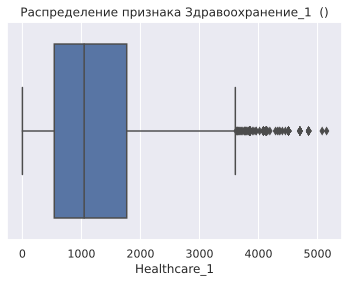

In [159]:
# Боксплот данного признака 
draw_boxplot(train_data[num_cols[11]], "Распределение признака Здравоохранение_1  ()")

In [160]:
# Описательная статистика признака
train_data.Healthcare_1.describe()

count    10000.000000
mean      1209.341741
std        942.481590
min          0.000000
25%        540.000000
50%       1046.000000
75%       1767.133840
max       5153.624060
Name: Healthcare_1, dtype: float64

<p> Примерно половина значений данного признака отсутствовали и были заменены на случайные значения (нормально распределенные). Несмотря на модификацию признака,сохранилось довольно большое количество выбросов. Из-за наличия выбросов среднее значение смещено вправо от медианного (наличие толстого хвоста справа) </p>

In [161]:
# Определим значение границы выбросов
health = train_data.Healthcare_1.quantile(1-0.025)
print(health)

3558.2666896589853


In [162]:
h_drops = train_data.Healthcare_1.loc[train_data.Healthcare_1 > health]
h_drops

Id
12774    4702.000000
739      4087.000000
14687    3659.148803
13290    4129.000000
4026     4508.000000
            ...     
13653    3855.000000
4956     3582.667684
4578     4129.000000
2548     3855.000000
1103     3957.406951
Name: Healthcare_1, Length: 250, dtype: float64

In [163]:
# В зону выбросов попало 250 значений, обработаем выбросы заменив их медианными значениями
train_data.Healthcare_1.loc[h_drops.index] = train_data.Healthcare_1.median()

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


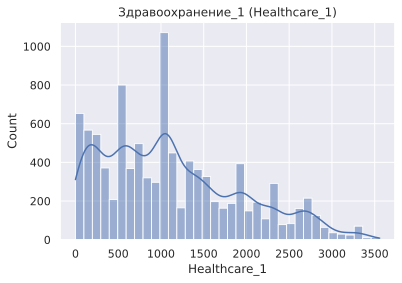

In [164]:
# Выведем гистограмму данного признака после преобразования
draw_gist(train_data[num_cols[11]], "Здравоохранение_1 (Healthcare_1)")

In [165]:
# Обновленная описательная статистика
train_data.Healthcare_1.describe()

count    10000.000000
mean      1129.912138
std        807.740433
min          0.000000
25%        540.000000
50%       1046.000000
75%       1633.622477
max       3557.641023
Name: Healthcare_1, dtype: float64

<p> В результате обработки выбросов, среднее значение сместилось ближе медианному значению. Распределение признака по прежнему имеет тяжелый правый хвост.</p>

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


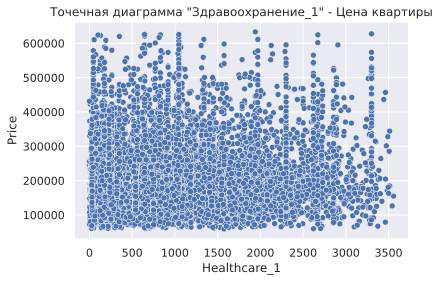

In [166]:
# проанализируем влияние признака на Цену квартиры Price
draw_scatter(x_data = train_data[num_cols[11]], y_data = train_data['Price'], title = 'Точечная диаграмма "Здравоохранение_1" - Цена квартиры')

In [167]:
# Коэффициент корреляции
train_data[['Healthcare_1','Price']].corr()

,Healthcare_1,Price
Healthcare_1,1.000000,0.025045
Price,0.025045,1.000000


<p> Расчет коэффициента показал практически отсутствие прямой корреляции между величинами. Однако точечна диаграмма показывает, что количество квартир среднего и высокого сегмента снижается по мере увеличения признака. Данное наблюдени выглядит закономерным если считать что данный признака показывает расстояние до ближайшего объекта здравоохранения (поликлинники). </p>

In [168]:
# отберем экземпляры данных с показателем Цены Price >= 400 000
midle_price = train_data[['Healthcare_1','Price']].loc[train_data.Price >= 400000]
midle_price

,Healthcare_1,Price
Id,,
535,2620.000000,512797.373401
191,903.729516,481360.360728
1550,669.515286,421803.748753
8553,811.544341,410883.892020
3876,770.000000,600903.828562
...,...,...
6149,229.000000,492943.252891
5383,147.122714,418817.004446
16557,1162.702729,403476.612413


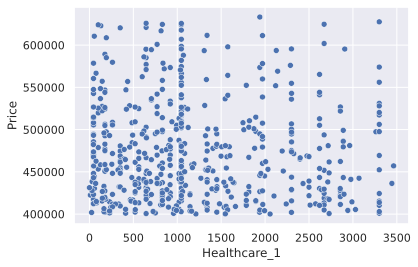

In [169]:
sns.scatterplot(x = midle_price.Healthcare_1, y = midle_price.Price)

In [170]:
midle_price.corr() # начинает проявлятся отрицательная корреляция

,Healthcare_1,Price
Healthcare_1,1.00000,-0.02979
Price,-0.02979,1.00000


### Shops_1 - Магазины_1

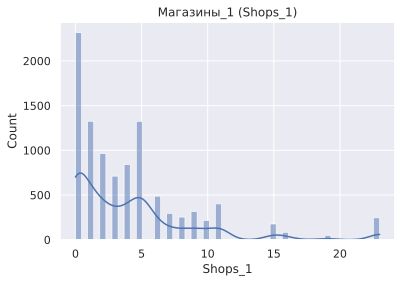

In [171]:
# Перейдем к признаку Магазины_1 (Shops_1). Выведем гистограмму признака
draw_gist(train_data[num_cols[13]], "Магазины_1 (Shops_1)")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


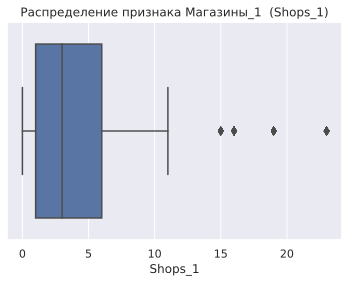

In [172]:
# Боксплот для данного признака
draw_boxplot(train_data[num_cols[13]], "Распределение признака Магазины_1  (Shops_1)")

<p> Распределение данного признака имеет отличия от нормального. Имеется несколько пиков на наиболее часто встречающихся значениях, тяжелый правый хвост распределения и 4 выброса. </p>

In [173]:
train_data.Shops_1.describe()

count    10000.000000
mean         4.231300
std          4.806341
min          0.000000
25%          1.000000
50%          3.000000
75%          6.000000
max         23.000000
Name: Shops_1, dtype: float64

In [174]:

# обработаем выбросы заменив медианными значениями
train_data.Shops_1.loc[train_data.Shops_1 > 13] = train_data.Shops_1.median()

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [175]:
train_data.Shops_1.describe()

count    10000.000000
mean         3.343800
std          3.083172
min          0.000000
25%          1.000000
50%          3.000000
75%          5.000000
max         11.000000
Name: Shops_1, dtype: float64

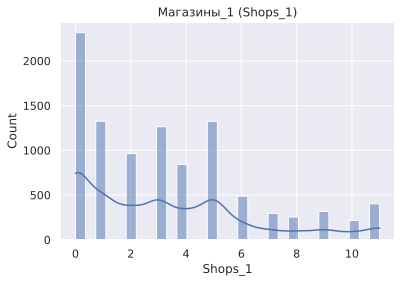

In [176]:
# после устранения выбросов среднее значение оказалось ближе к медианному
draw_gist(train_data[num_cols[13]], "Магазины_1 (Shops_1)")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


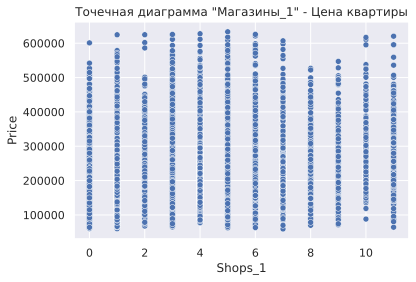

In [177]:
# оценим влияние признака Магазины_1 (Shops_1) на цену Price
draw_scatter(x_data = train_data[num_cols[13]], y_data = train_data['Price'], title = 'Точечная диаграмма "Магазины_1" - Цена квартиры')

In [178]:
# коэффициент корреляции 
train_data[['Shops_1', 'Price']].corr()

,Shops_1,Price
Shops_1,1.000000,0.292301
Price,0.292301,1.000000


<p> Коэффициент корреляции показал слабое положительное влияиние на стоимость квартиры. В свою очередь точечная диаграмма свидетльствует о наличии квартир одинаковой стоимости в группах с низкими и высокими знчениями параметра Shops_1. Скорее всего также присутствует нелинейная зависимость. Наличие развитой торговой сети в округе может дать небольшую добавку стоимости при прочих равных условиях.</p>

### Distric_iso - Район

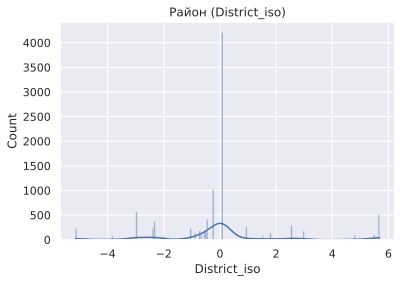

In [179]:
# Перейдем к признаку Район (District_iso). Выведем гистограмму признака
draw_gist(train_data[num_cols[14]], "Район (District_iso)")

In [180]:
train_data.District_iso.describe()

count    1.000000e+04
mean     8.660628e-16
std      2.115983e+00
min     -5.141586e+00
25%     -4.903207e-01
50%      8.910021e-02
75%      8.910021e-02
max      5.684685e+00
Name: District_iso, dtype: float64

In [181]:
train_data.District_iso.value_counts(bins = 5).head()

(-0.811, 1.354]                  6578
(-2.976, -0.811]                 1015
(-5.1530000000000005, -2.976]     964
(1.354, 3.519]                    739
(3.519, 5.685]                    704
Name: District_iso, dtype: int64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


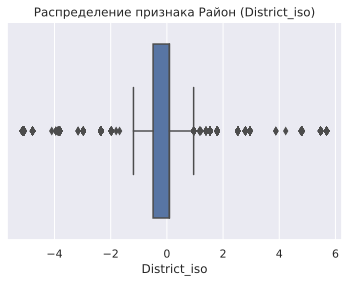

In [182]:
# Боксплот для данного признака
draw_boxplot(train_data[num_cols[14]], "Распределение признака Район (District_iso)")

<p> Данный признака является закодированной меткой Района города (District), качественного признака, обозначающего расположение в том или инома районе города. Данный признака был закодирован в разреженные вектора и сжат при помощи метода isomap чтобы излишне не увеличивать пространство признаков. Статистические характеристики показывают большое количество выбросов. Поскольку признак является закодированными метками районов обрабатывать выбросы не целесообразно </p>

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


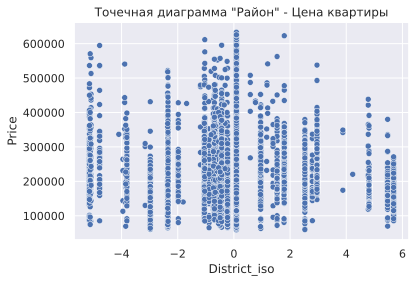

In [183]:
# рассмотрим точечную диаграмма District_iso и цены квартиры Price
draw_scatter(x_data = train_data[num_cols[14]], y_data = train_data['Price'], title = 'Точечная диаграмма "Район" - Цена квартиры')

In [184]:
# коэффициент корреляции
train_data[['District_iso','Price']].corr()

,District_iso,Price
District_iso,1.000000,-0.003127
Price,-0.003127,1.000000


<p> Коэффициент корреляции ожидаемо показывает отсутствие зависимост. В свою очередь, точечна диаграмма  демонстрирует ряд кластеров в которы отсутствует сегмент жилья высокой стоимости, в ряде районов наоборот преобладает жилье среднего сегмента, отсутсвует сверхдешевое и сверхдорогое жилье.</p>

## 3.2. Анализ качественных признаков

<h3 id = "part3.2"> 3.2. Анализ качественных признаков</h3>

In [185]:
# Перейдем к рассмотрению качественных признаков 
cat_cols

['DistrictId',
 'Ecology_2',
 'Ecology_3',
 'Shops_2',
 'LifeSquare_NA',
 'Healthcare_1_NA',
 'First_floor',
 'Last_floor',
 'Large_kitchen']

### District - Район

([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44,
  45,
  46,
  47,
  48,
  49,
  50,
  51,
  52,
  53,
  54,
  55,
  56,
  57,
  58,
  59,
  60,
  61,
  62,
  63,
  64,
  65,
  66,
  67,
  68,
  69,
  70,
  71,
  72,
  73,
  74,
  75,
  76,
  77,
  78,
  79,
  80,
  81,
  82,
  83,
  84,
  85,
  86,
  87,
  88,
  89,
  90,
  91,
  92,
  93,
  94,
  95,
  96,
  97,
  98,
  99,
  100,
  101,
  102,
  103,
  104,
  105,
  106,
  107,
  108,
  109,
  110,
  111,
  112,
  113,
  114,
  115,
  116,
  117,
  118,
  119,
  120,
  121,
  122,
  123,
  124,
  125,
  126,
  127,
  128,
  129,
  130,
  131,
  132,
  133,
  134,
  135,
  136,
  137,
  138,
  139,
  140,
  141,
  142,
  143,
  144,
  145,
  146,
  147,
  148,
  149,
  150,
  151,
  152,
  153,
  154,
  155,
  156,
  157,
  15

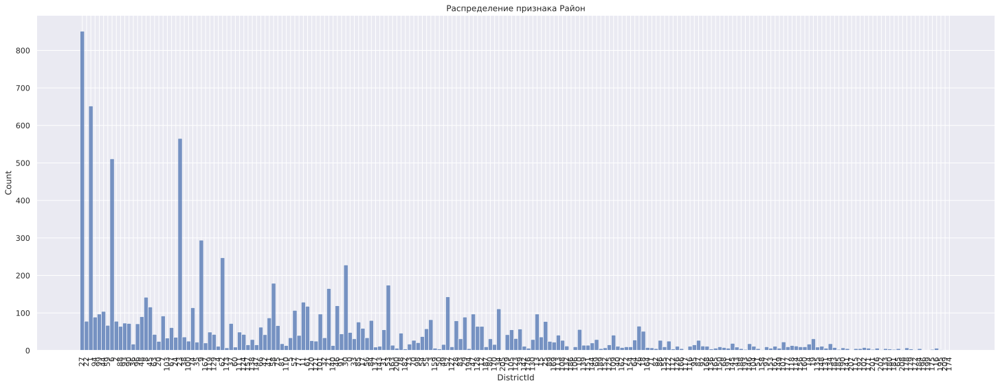

In [186]:
# Проанализируем признак Район (District)
plt.figure(figsize = (25,9))
plt.title('Распределение признака Район')
train_data.DistrictId = train_data.DistrictId.astype('str')
sns.histplot(train_data.DistrictId)
plt.xticks(rotation = 90)

In [187]:
# Гистограмма признака (также как и закодированного) показывает наличие ряда густонаселенных районов, которые лидируют с большим отрывом 
train_data.DistrictId.value_counts().head(5)

27    851
1     652
23    565
6     511
9     294
Name: DistrictId, dtype: int64

In [188]:
# c помощью однофакторного дисперсионного анализа попробуем найти статистически значимые различия цены в цене квартиры в зависимости от района
# интуици подсказвает, что данные различия имеют место быть
anova_test( x_data = train_data.DistrictId, y_data = train_data.Price)

['27' '1' '23' '6' '9' '62' '30' '58' '53' '21' '52' '8' '11' '46' '61'
 '45' '74' '34' '57' '44' '47' '99' '101' '13' '7' '48' '29' '94' '41' '3'
 '84' '28' '2' '22' '25' '85' '93' '90' '37' '96' '59' '75' '26' '88'
 '128' '12' '66' '67' '17' '55' '39' '10' '105' '31' '18' '119' '111' '0'
 '78' '91' '124' '129' '63' '42' '79' '109' '113' '77' '54' '38' '15' '24'
 '32' '5' '56' '103' '123' '33' '80' '83' '19' '130' '138' '69' '64' '86'
 '70' '108' '87' '120' '122' '121' '100' '89' '20' '107' '35' '169' '98'
 '167' '144' '145' '146' '134' '81' '14' '73' '36' '49' '170' '125' '157'
 '95' '147' '163' '151' '139' '140' '110' '118' '114' '132' '92' '143' '4'
 '116' '104' '148' '40' '126' '142' '168' '161' '72' '155' '154' '177'
 '150' '127' '106' '156' '97' '187' '160' '43' '137' '60' '135' '162'
 '183' '164' '102' '68' '190' '152' '178' '71' '173' '159' '16' '200'
 '153' '131' '165' '176' '191' '149' '171' '76' '188' '133' '65' '189'
 '166' '115' '194' '192' '51' '82' '141' '184' '136' '17

<p> Действительно гипотеза о том, что на стоимость квартиры влияет район её нахождения нашла подтверждение в исследуемых данных. Соответствено признаки DistrictId и District_iso могут быть полезы для построения модели.</p>

### Ecology_2 - Экология_2

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


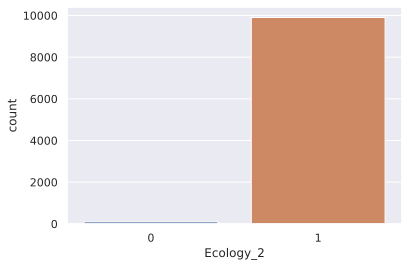

In [189]:
# Перейдем к признаку Экология_2  (Ecology_2)
# Гистограма признака
sns.countplot(train_data.Ecology_2)

In [190]:
train_data.Ecology_2.value_counts()

1    9903
0      97
Name: Ecology_2, dtype: int64

In [191]:
# На диаграмме виден явный дисбаланс в классах Экология_2. К первому класу относятся лишь 97 экземпляров данных
# Тем не менее проведем односторонний дисперсионных анализ, чтобы выявить наличие отличий в уровне цен между классами
anova_test(x_data= train_data.Ecology_2, y_data= train_data.Price)

[1 0]
Количество категорий к = 2, Количество значений n = 10000
 Значение расчетного критерия 5.009677458089046 больше критического 3.842389086957426, следовательно в группах по 
              данному категориальному признаку есть значимые отличия (p-value 0.025227927995423487) 


<p> Несмотря на явный дисбаланс между классами в признаке Ecology_2, выявлено статистически значимые отличия в уровне цен между классами. </p>

### Ecology_3 - Экология_3

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


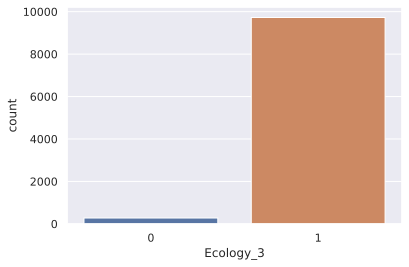

In [192]:
# Следующий признак Экология_3 (Ecology_3)
# Гистограма признака
sns.countplot(train_data.Ecology_3)

In [193]:
train_data.Ecology_3.value_counts()

1    9725
0     275
Name: Ecology_3, dtype: int64

In [194]:
# По данному признаку также заметен дисбаланс между классами, оценим влияние признака на целевой показатель Price
anova_test(x_data= train_data.Ecology_3, y_data= train_data.Price)

[1 0]
Количество категорий к = 2, Количество значений n = 10000
 Значение расчетного критерия 27.723250082860478 больше критического 3.842389086957426, следовательно в группах по 
              данному категориальному признаку есть значимые отличия (p-value 1.428761770062292e-07) 


<p> Несмотря на явный дисбаланс между классами в признаке Ecology_3, выявлено статистически значимые отличия в уровне цен между классами. Использование данного признака может быть целесообразно для построения предиктивной модели </p>

### Shops_2 - Магазины_2

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


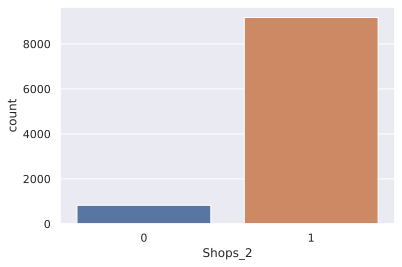

In [195]:
# Перейдем к рассмотрению признака  Магазины_2(Shops_2)
# категориальая гистограмма по данному признаку

sns.countplot(train_data.Shops_2)

In [196]:
# данный признак также представлен двумя несбалансированными классами
train_data.Shops_2.value_counts()

1    9175
0     825
Name: Shops_2, dtype: int64

In [197]:
# Оценим влияине данного признака на вариативность целевой переменной
anova_test(x_data= train_data.Ecology_3, y_data= train_data.Price)

[1 0]
Количество категорий к = 2, Количество значений n = 10000
 Значение расчетного критерия 27.723250082860478 больше критического 3.842389086957426, следовательно в группах по 
              данному категориальному признаку есть значимые отличия (p-value 1.428761770062292e-07) 


<p> Расчеты выявили наличие статистически значимых различий в цене между классами по данному признаку. Скорее всего данный признак будет полезен для предиктивной модели.</p>

### First_floor - Первый этаж

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


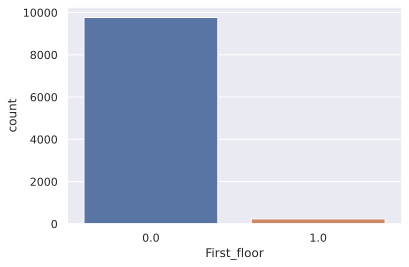

In [198]:
# Следующий признак Первый этаж  (First_floor) является дополнительным признаком, созданным на основе имеющихс данных
# посмотрим есть ли у данного признака статистически значимое влияние на Цену квартиры
sns.countplot(train_data.First_floor)

In [199]:
# объектов расположенных на первом этаже оказалось очень небольшое количество
train_data.First_floor.value_counts()

0.0    9765
1.0     235
Name: First_floor, dtype: int64

In [200]:
# С помощью дисперсионного анализа определим имеют ли занчимые отличия в цене квартиры, расположенные на первых этажах
anova_test(x_data= train_data.First_floor, y_data= train_data.Price)

[0. 1.]
Количество категорий к = 2, Количество значений n = 10000
 Значение расчетного критерия 30.366143960813265 больше критического 3.842389086957426, следовательно в группах по 
              данному категориальному признаку есть значимые отличия (p-value 3.665923186894228e-08) 


In [201]:
# Проверим выводы дисперсионного анализа расчетом средней цены квартиры в каждом классе
train_data[['First_floor','Price']].groupby('First_floor').mean()

,Price
First_floor,
0.0,214931.617886
1.0,181197.129047


In [202]:
# Действительно цена квартир, расположенный на первом этаже заметно ниже
# Подкрепим различия между классами оценив доверительный интервал для средней величины квартир, расположенных не на первом этаже
pp0 = train_data.Price.loc[train_data.First_floor == 0.0]
pp1 = train_data.Price.loc[train_data.First_floor == 1.0]
print('Для квартир не на первом этаже ', trust_interval(data = pp0))
print('Для квартир НА первом этаже ', trust_interval(data = pp1))

Для квартир не на первом этаже  Матожидание генеральной совокупности c вероятностью 95.0% находится в интервале от  213083.02105445598 до 216780.21471848615
Для квартир НА первом этаже  Матожидание генеральной совокупности c вероятностью 95.0% находится в интервале от  172101.1569282478 до 190293.10116531522


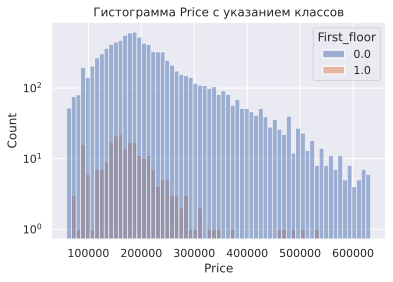

In [203]:
# Гистограмма стоимости квартиры с обозначением классов
plt.title('Гистограмма Price c указанием классов')
plt.yscale('log') # логарифмическа шкала из-за разности маштабов классов
sns.histplot(train_data, x = 'Price', hue = 'First_floor')

<p> Дисперсионный анализ и расчет доверительного интервала подтвердили, что квартиры располженные не на первом этаже образуют отдельную генеральную совокупность (гипотеза, что класс квартир на первом этаже лишь выборка из генеральной совокупности отвергнута), соответствено выделение их в отдельных класс целесообразно для построения предиктивной модели. </p>

### Last_floor - Последний этаж

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


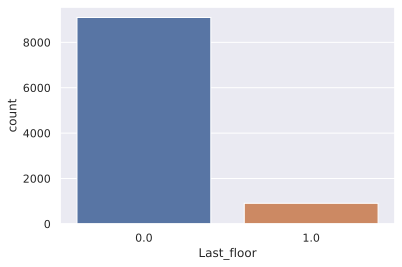

In [204]:
# Проанализируем похожий признак Послединй этаж. Last_Floor является дополнительным признаком, созданным на основе имеющихс данных
# посмотрим есть ли у данного признака статистически значимое влияние на Цену квартиры
sns.countplot(train_data.Last_floor)

In [205]:
# объектов расположенных на последнем этаже также относительно немного
train_data.Last_floor.value_counts()

0.0    9095
1.0     905
Name: Last_floor, dtype: int64

In [206]:
# С помощью дисперсионного анализа определим имеют ли значимые отличия в цене квартиры, расположенные на последних этажах
anova_test(x_data= train_data.Last_floor, y_data= train_data.Price)

[0. 1.]
Количество категорий к = 2, Количество значений n = 10000
 Значение расчетного критерия 0.01932841245954807 меньше критического 3.842389086957426, следовательно в группах  по 
              данному категориальному признаку не имеется статистически значимых отличий (p-value 0.8894318813438994)


In [207]:
# Проверим выводы дисперсионного анализа расчетом средней цены квартиры в каждом классе
train_data[['Last_floor','Price']].groupby('Last_floor').mean()

,Price
Last_floor,
0.0,214179.588720
1.0,213729.518869


In [208]:
# Действительно средние значения расположены довольо близко. Рассчитаем доверительные интервалы
pp0 = train_data.Price.loc[train_data.Last_floor == 0.0]
pp1 = train_data.Price.loc[train_data.Last_floor == 1.0]
print('Для квартир не на последнем этаже ', trust_interval(data = pp0))
print('Для квартир НА последнем этаже ', trust_interval(data = pp1))

Для квартир не на последнем этаже  Матожидание генеральной совокупности c вероятностью 95.0% находится в интервале от  212270.49104682583 до 216088.6863936711
Для квартир НА последнем этаже  Матожидание генеральной совокупности c вероятностью 95.0% находится в интервале от  207679.31292539573 до 219779.72481322056


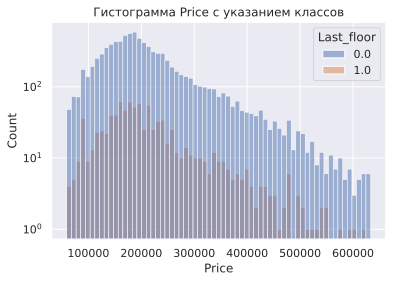

In [209]:
# Доверительные интервалы средник величин имеют пересчения, что подтверждает вывод о том что классы являются выборками из одной совокупности
# Гистограмма стоимости квартиры с обозначением классов
plt.title('Гистограмма Price c указанием классов')
plt.yscale('log') # логарифмическа шкала из-за разности маштабов классов
sns.histplot(train_data, x = 'Price', hue = 'Last_floor')

<p> К созжанию, расчеты показали, что гипотеза о том, что квартиры расположенные на последнем этаже имеют цену отличную от квартир, расположенных на иных этажах не нашла подтверждения на исследуемых данных. Соответственно применение данного признака для построения модели не целесообразно, так как он не несет никакой дополнительной информации.</p>

### Large_kitchen - Большая кухня

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


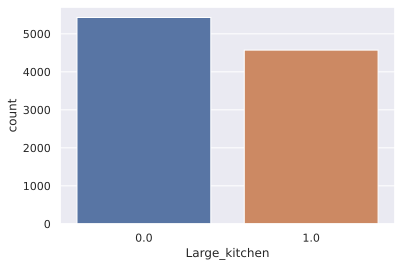

In [210]:
# Перейдем к анализу признака Большая кухня (Large_kitchen). Введение данного признака основано на гипотезе, что квартиры с большей площадью кухни более
# привлекательны для покупателей.
sns.countplot(train_data.Large_kitchen)

In [211]:
# этот раз классы оказались более сбалансированными, так как применялось среднее значение
train_data.Large_kitchen.value_counts()

0.0    5429
1.0    4571
Name: Large_kitchen, dtype: int64

In [212]:
# определим есть ли значимые отличия в цене квартиры между классами
anova_test(x_data= train_data.Large_kitchen, y_data= train_data.Price)

[0. 1.]
Количество категорий к = 2, Количество значений n = 10000
 Значение расчетного критерия 946.5528987040776 больше критического 3.842389086957426, следовательно в группах по 
              данному категориальному признаку есть значимые отличия (p-value 1.1165166664669538e-198) 


In [213]:
# таким образом выделение отдельного признака Большая кухня указывает на то что в данных группах есть статистически значимые отличия в уровне цен
train_data[['Large_kitchen','Price']].groupby('Large_kitchen').mean()

,Price
Large_kitchen,
0.0,189078.712433
1.0,243902.919315


In [214]:
# Действительно, квартиры с кухней размером меньше среднего в среднем стоят несколько дешевле.
# С помощью доверительных итервалов оценим дейстительно ли это отличие статистически значимо
pp0 = train_data.Price.loc[train_data.Large_kitchen == 0.0]
pp1 = train_data.Price.loc[train_data.Large_kitchen == 1.0]
print('Для квартир c площадью кухни меньше среднего ', trust_interval(data = pp0))
print('Для квартир с кухней БОЛЬШЕ среднего ', trust_interval(data = pp1))

Для квартир c площадью кухни меньше среднего  Матожидание генеральной совокупности c вероятностью 95.0% находится в интервале от  187160.315329055 до 190997.1095363986
Для квартир с кухней БОЛЬШЕ среднего  Матожидание генеральной совокупности c вероятностью 95.0% находится в интервале от  240853.21449613292 до 246952.6241344118


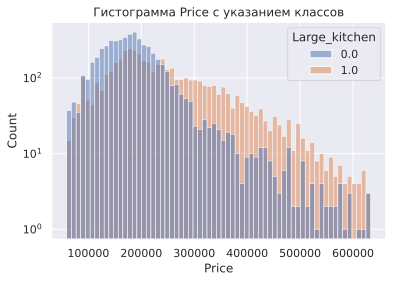

In [215]:
# Оценка доверительных интервалов и дисперсионый анализ указывают на статистически значимые отличия между классами данного признака. Выведем гистограмму
plt.title('Гистограмма Price c указанием классов')
plt.yscale('log') # логарифмическа шкала из-за разности маштабов классов
sns.histplot(train_data, x = 'Price', hue = 'Large_kitchen')

<p> Добавление категориального признака Большая кухня выявило статистически значимые отличия между квартирами с площадью кухни больше среднего значения. При этом гистограма распределени классов указыват, что наибольшее влияине на цену квартиры данный признка начинает оказывать при уровне цен более 300 000. Таким образомм данный признак целесообразно применить для машинного обучения.</p>

<p> По итогам исследования количественных и качественных признаков стало возможным определить еще несколько дополнительных качественных признаков </p>

## 3.3. Добавление новых признаков после EDA

### Room_square - Средний размер комнаты

In [216]:
# Введем дополнительный признк учитывающий характер планировки квартиры - Средний размер комнаты (Room_square)
# Признак будем расчитывать делением Общей площади (Square) на число комнат (Rooms).
# Гипотеза будет заключаться в том, что жилье комфорт и премиум класса, "улучшенной планировки" советской эпохи будет иметь больший размер комнат в отличие от массовой застроки
# Показатель общей площади выбран так как в нем отсуствовали пропущенные значения, а значит он ближе к сырым данным.
train_data['Room_square'] = train_data.Square / train_data.Rooms

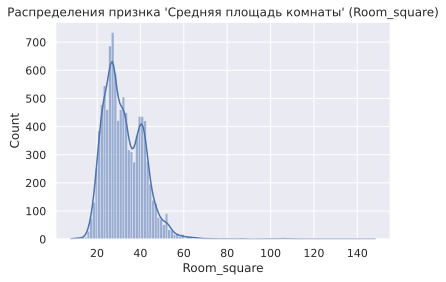

In [217]:
# Выведем гистограмму распределения нового признака
draw_gist(train_data.Room_square, "Распределения признка 'Средняя площадь комнаты' (Room_square)")

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


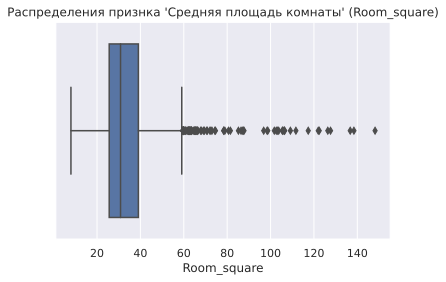

In [218]:
# Боксплот для данного признка
draw_boxplot(data = train_data.Room_square, title = "Распределения признка 'Средняя площадь комнаты' (Room_square)" )

In [219]:
# Описательная статистика
train_data.Room_square.describe()

count    10000.000000
mean        32.440491
std          9.709326
min          7.981216
25%         25.623349
50%         30.847462
75%         39.056688
max        148.179026
Name: Room_square, dtype: float64

<p> Распределение данного признака имеет отклонения от нормального распредления. Гистограмма имеет два пика - первый в райне среднего значения, второй в районе 75% квантиля. Скоре всего подвтерждается гипотеза о статистически значимыз отличия жилья верхнего ценогового сегмента, у которого средний размер комныты больше и имеющео свой закон распределения. Распределение также имеет тяжелый правый хвост и значительный объем выбросов. Поскольку при расчете признаки уже прошли очистку от выбросов здель выбросы обрабатывать не будем. Тем не менее, за счет выбрысов среднее значение немного смещено вправо от медианного.</p>

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


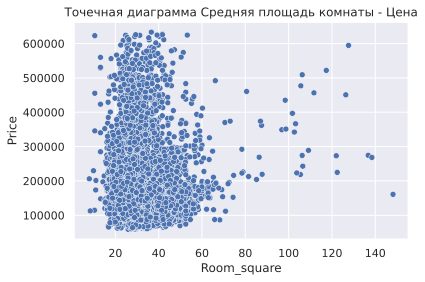

In [220]:
# Расссмотрим влияние данного признака на Цену квартиры ('Price')
draw_scatter(x_data= train_data.Room_square, y_data = train_data.Price, title= "Точечная диаграмма Средняя площадь комнаты - Цена")

In [221]:
# Коэффициент корреляции
train_data[['Room_square', 'Price']].corr()

,Room_square,Price
Room_square,1.000000,-0.222371
Price,-0.222371,1.000000


<p> Коэффициент корреляции показывает слабую отрицательноую корреляцию. В свою очередь на точечной диаграмме сформировались две области точек. Первый кластер в диапазоне по оси X от 0 до 60 без какой либо выраженной зависимости. Второй кластер с площадью комнаты от 60 где наблюдает тенденция повышения Цены при росте площади квартриы </p>

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


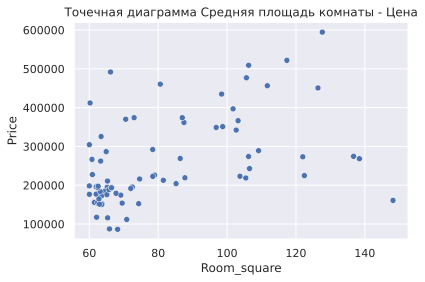

In [222]:
lr = train_data[['Room_square', 'Price']].loc[train_data.Room_square > 60]
draw_scatter(x_data= lr.Room_square, y_data = lr.Price, title= "Точечная диаграмма Средняя площадь комнаты - Цена")

In [223]:
lr.corr()

,Room_square,Price
Room_square,1.000000,0.493658
Price,0.493658,1.000000


### Epoch_1950, Epoch_1999, Epoch_2000 - Эпоха застройки

In [224]:
# Входе исследования признака Год постройки (HouseYear) было обнаружено, что город испытал примерно три волны застройки
# К первому периоду до 1950 года относятся объекты дореволюционной постройки и раннего советского периода, к нему относятя и так называемые "Сталинки"
# Следующая волна пришлась на период 1950-1999 - массового строительства типового жилья и возникновение спальных микрорайонов
# Последний кластер относится к периоду с 2000 года - на который приходится период восстановления экономики комплексной застройки новым типовым жильем, присоединение Новой Москвы
# Целесообразно для каждого периода ввести соотвествующий признак
train_data['Epoch_1950'] = pd.Series(data = np.zeros(10000), index = train_data.index) # заполняем признаки нулевыми значениям
train_data['Epoch_1999'] = pd.Series(data = np.zeros(10000), index = train_data.index)
train_data['Epoch_2000'] = pd.Series(data = np.zeros(10000), index = train_data.index)

train_data['Epoch_1950'].loc[train_data.HouseYear <= 1950] = 1 # эпоха раннего советского периода
train_data['Epoch_1999'].loc[(train_data.HouseYear > 1950) & (train_data.HouseYear <= 1999)] = 1 # волна послевоенной застройки
train_data['Epoch_2000'].loc[train_data.HouseYear >= 2000] = 1 # эпоха 2000x

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [225]:
train_data[['Epoch_1950', 'Epoch_1999', 'Epoch_2000']].value_counts()

Epoch_1950  Epoch_1999  Epoch_2000
0.0         1.0         0.0           7317
            0.0         1.0           2599
1.0         0.0         0.0             84
dtype: int64

In [226]:
# Проанализируем полученные признаки на статистически значимое влияние на целеов показтель Цена квартир
# Начнем с признака Epoch_1950
anova_test(x_data= train_data.Epoch_1950, y_data= train_data.Price)

[0. 1.]
Количество категорий к = 2, Количество значений n = 10000
 Значение расчетного критерия 194.85425340299815 больше критического 3.842389086957426, следовательно в группах по 
              данному категориальному признаку есть значимые отличия (p-value 7.145592648573665e-44) 


In [227]:
# ожидаемо Цена на объекты до 1950 года постройки имеет статистическ значимы отличия
train_data[['Epoch_1950','Price']].groupby('Epoch_1950').mean()

,Price
Epoch_1950,
0.0,212957.060411
1.0,353647.177952


In [228]:
# стоимость "раритетных" объектов оказалась заметно выше
# удостоверимся в наличии статистическ значимой разницы в средней стоимости оценкой доверительного интервала
pp0 = train_data.Price.loc[train_data.Epoch_1950 == 0.0]
pp1 = train_data.Price.loc[train_data.Epoch_1950 == 1.0]
print('Для объектов после 1950 года ', trust_interval(data = pp0))
print('Для объектов СТАРШЕ 1950 ', trust_interval(data = pp1))

Для объектов после 1950 года  Матожидание генеральной совокупности c вероятностью 95.0% находится в интервале от  211152.6469930923 до 214761.4738297007
Для объектов СТАРШЕ 1950  Матожидание генеральной совокупности c вероятностью 95.0% находится в интервале от  326894.94159966835 до 380399.41430452245


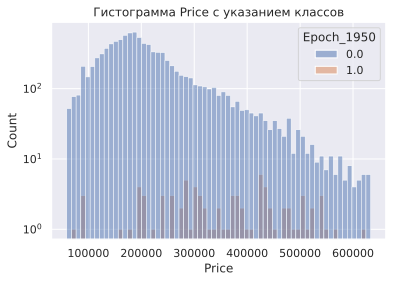

In [229]:
# Гипотеза с выделением в отдельный класс объектов до 1950 года постройки нашла статистически значимое подтверждение
plt.title('Гистограмма Price c указанием классов')
plt.yscale('log') # логарифмическа шкала из-за разности маштабов классов
sns.histplot(train_data, x = 'Price', hue = 'Epoch_1950')

<p> Распределение объектов, построеных до 1950 года имеет значительное смещени в правую сторону и явно образуют отдельную совокупность.</p> 

In [230]:
# Проанализируем полученные признаки на статистически значимое влияние на целеов показтель Цена квартир
# Начнем с признака Epoch_1999
anova_test(x_data= train_data.Epoch_1999, y_data= train_data.Price)

[1. 0.]
Количество категорий к = 2, Количество значений n = 10000
 Значение расчетного критерия 136.36080935597266 больше критического 3.842389086957426, следовательно в группах по 
              данному категориальному признаку есть значимые отличия (p-value 2.6554142070506255e-31) 


In [231]:
# ожидаемо Цена на объекты до 1950 года постройки имеет статистическ значимы отличия
train_data[['Epoch_1999','Price']].groupby('Epoch_1999').mean()

,Price
Epoch_1999,
0.0,231928.501175
1.0,207615.744886


In [232]:
# стоимость объектов  второй половины 20 века оказалась заметно ниже
# удостоверимся в наличии статистическ значимой разницы в средней стоимости оценкой доверительного интервала
pp0 = train_data.Price.loc[train_data.Epoch_1999 == 0.0]
pp1 = train_data.Price.loc[train_data.Epoch_1999 == 1.0]
print('Для объектов ВНЕ периода 1950-1999 года ', trust_interval(data = pp0))
print('Для объектов 1950-1999 ', trust_interval(data = pp1))

Для объектов ВНЕ периода 1950-1999 года  Матожидание генеральной совокупности c вероятностью 95.0% находится в интервале от  227526.66394266117 до 236330.33840795027
Для объектов 1950-1999  Матожидание генеральной совокупности c вероятностью 95.0% находится в интервале от  205744.07242300652 до 209487.41734986182


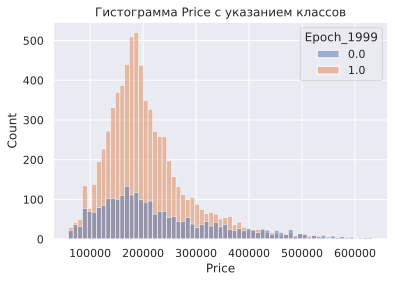

In [233]:
# Гипотеза с выделением в отдельный класс объектов период 1950-1960 года постройки нашла статистически значимое подтверждение
plt.title('Гистограмма Price c указанием классов')
#plt.yscale('log') # логарифмическа шкала из-за разности маштабов классов
sns.histplot(train_data, x = 'Price', hue = 'Epoch_1999')

<p> Распределение объектов, построеных в период 1950-1999годы  имеет значительное смещени в левую сторону сторону. Такие квартиры рынок в стреднем относит к более дешевому жилью массового сегмента

In [234]:
# Последний признакх относится к эпохе современности Epoch_2000
anova_test(x_data= train_data.Epoch_2000, y_data= train_data.Price)

[0. 1.]
Количество категорий к = 2, Количество значений n = 10000
 Значение расчетного критерия 78.77058945568456 больше критического 3.842389086957426, следовательно в группах по 
              данному категориальному признаку есть значимые отличия (p-value 8.171787754849159e-19) 


In [235]:
# ожидаемо Цена на объекты до 1950 года постройки имеет статистическ значимы отличия
train_data[['Epoch_2000','Price']].groupby('Epoch_2000').mean()

,Price
Epoch_2000,
0.0,209273.175014
1.0,227994.538555


In [236]:
# стоимость квартир современной эпохи объектов оказалась заметно выше
# удостоверимся в наличии статистическ значимой разницы в средней стоимости оценкой доверительного интервала
pp0 = train_data.Price.loc[train_data.Epoch_2000 == 0.0]
pp1 = train_data.Price.loc[train_data.Epoch_2000 == 1.0]
print('Для объектов ДО 2000 года ', trust_interval(data = pp0))
print('Для объектов ПОСЛЕ 2000 ', trust_interval(data = pp1))

Для объектов ДО 2000 года  Матожидание генеральной совокупности c вероятностью 95.0% находится в интервале от  207365.85419769277 до 211180.49583122617
Для объектов ПОСЛЕ 2000  Матожидание генеральной совокупности c вероятностью 95.0% находится в интервале от  223613.72128701166 до 232375.35582369953


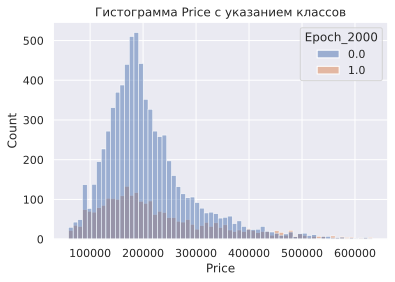

In [237]:
# Гипотеза с выделением в отдельный класс объектов после 2000 года постройки нашла статистически значимое подтверждение
plt.title('Гистограмма Price c указанием классов')
#plt.yscale('log') # логарифмическа шкала из-за разности маштабов классов
sns.histplot(train_data, x = 'Price', hue = 'Epoch_2000')

<p> Распределение объектов, построеных после 2000 года имеет незначительное смещение вправо (стоят дороже). В свою очередь среди данного жилья значительна доля объектов эконом-класса</p> 

<p> Анализ данных дполнительных признаков показал, статистичеки значимое влияине на целевую переменную. Выделение данных признаков и использование их в модели целесообразно.</p>

## 3.4. Матрица корреляций

In [238]:
# Рассмтрим корреляцию данных в датасете. Определим наличие линейно зависимых параметров
corr_mat = train_data.corr()

In [239]:
# Для улучшения визуального представления заменим корреляции по модулю меньше 0.5 нулевыми значениям
corr_mat[corr_mat.abs() < 0.5] = 0

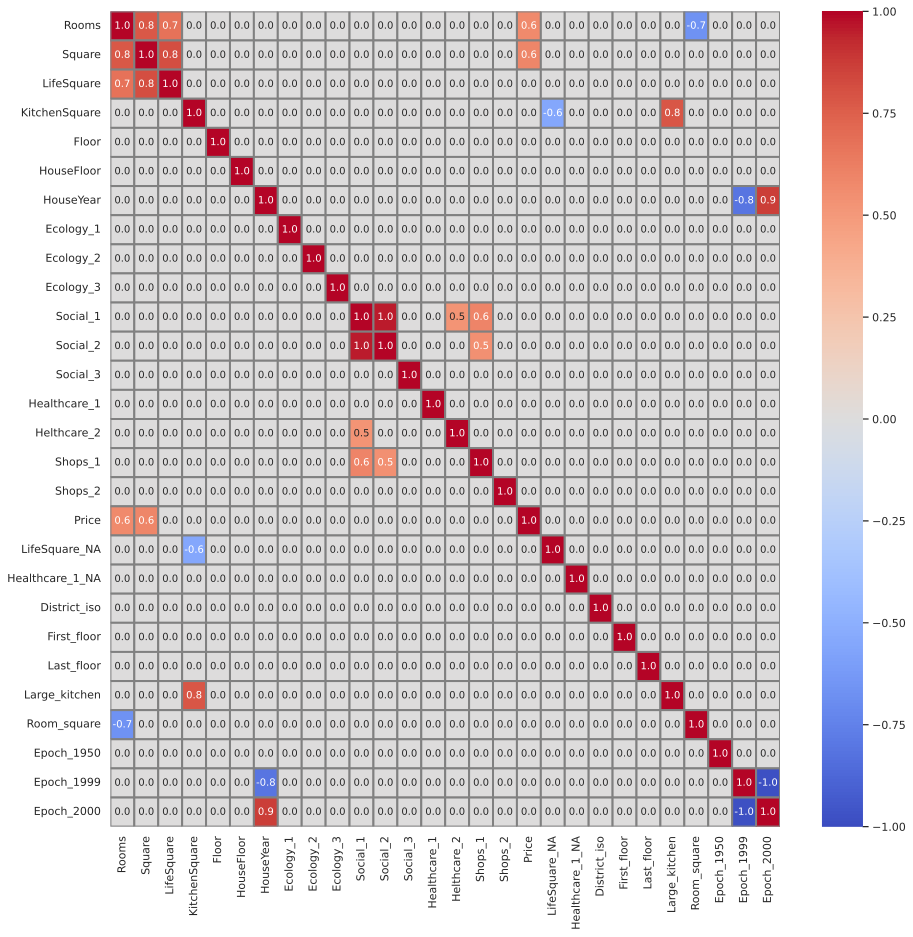

In [240]:
# тепловая карта корреляций
plt.figure(figsize= (15,15))
sns.heatmap(data = corr_mat, vmin = -1.0, vmax = 1.0, cmap = 'coolwarm', fmt = '.1f', annot= True, linewidths= 2, linecolor='grey')

<p> Сильная положительная корреляция наблюдает между линейно-зависимыми признаками, связанными с площадью квартры (производными от площади) - Square, Rooms, LifeSquare. Высокий уровень положительной корреляции показывают дополнительные  признаки с признаками из которых они вычислены - KitchenSquare - Large_kitchen, Rooms - Rooms_square (сильная обратная корреляция), HouseYear - Epoch_1999, Epoch_2000. Прямую обратную корреляцию имет признака Epoch_1999 - Epoch_2000. Скоррелированными признаками оказались Social_1 и Social_2  </p>

## 3.5 PrepareDataset - класс для подготовки датасета

In [241]:
#Клас для подготовки датасета
class PrepareDataset:
    def __init__(self):
        """ Инициализация необходимых полей класса """
        self.square_reg = None # поля для модели регрессии вычисляющей жилую площадь
        self.health_loc = None # поля для обработки пропусков по признакам HealthCare
        self.health_scale = None 
        self.district_max = 210 # максимальный индекс района
        self.dis_iso = None  # Поле для хранения модели сокрашения размерности
        self.l_coder = None # поле для кодирования меток признаков А B в классы 0 1
        self.med_kitch = None # порог для расчета признака "Large_kitchen"
        self.base_stat = None # хранение описательной статистики для набора данных
        return

    def fit(self, train_data):
        """ Расчет необходимых параметров для преобразования набора данных """

        #вычислим модель регрессии для параметра "LifeSquare"

        print('Расчет параметров для преобразования данных')
        print('Расчет регрессии для заполнения параметра "LifeSquare"')

        data = train_data.dropna() # выбрасываем пропущенные значения

        from sklearn.linear_model import LinearRegression
        self.square_reg = LinearRegression(fit_intercept= False) # инициализируем 
        print("Обучение модели регрессии...")
        self.square_reg.fit( X = data['Square'].values.reshape(-1,1), y = data["LifeSquare"])
        print("Модель обучена, коэффициент ",  self.square_reg.coef_)

        # Параметры распределения для признака "HealthCare1"
        print('Расчет параметров для заполнения пропусков "HealthCare1"')
        self.health_loc = train_data['Healthcare_1'].mean()
        self.health_scale = train_data['Healthcare_1'].std()
        print(f'Получены параметры loc = {self.health_loc}, scale = {self.health_scale}')

        # Кодирование DistrictId
        print("Бинаризация 'DistrictID'")
        cat1 =  [str(i) for i in range(self.district_max)]

        from sklearn.preprocessing import label_binarize
        train_data.DistrictId = train_data.DistrictId.astype('str')
        drict = label_binarize(train_data.DistrictId, classes= cat1)

        #сокращение размерности
        from sklearn.manifold import Isomap
        self.dis_iso = Isomap(n_components= 1)
        self.dis_iso.fit(X = drict)

        # Обучение объекта для кодирования меток
        print("Обучение кодера меток")
        from sklearn.preprocessing import LabelEncoder
        self.l_coder = LabelEncoder()
        self.l_coder.fit(data['Ecology_2'])
        print(f'Кодер меток готов {self.l_coder.classes_}')

        self.med_kitch = train_data.KitchenSquare.median()
        self.base_stat = train_data.describe()

        print("Расчет необходимых параметров завершен.")

        return

    def transform(self, test_data):
        """ Преобразует поученный датасет в соответствие с параметрами, рассчитаными в методе fit()
            Возвращает преобразованный набор данных в формате DataFrame"""
        print("Преобразование набора данных...")

       
        test_data.index = test_data['Id']
        test_data.pop('Id')
        print("Замена индексов на поле ID")
        
        #Заполнение отсутствующих значений по параметру "LifeSquare"

        #Сигнальный признак "LifeSquare_NA"
        test_data['LifeSquare_NA'] = 1 * test_data['LifeSquare'].isna() # соответственно где пропуски будут 1, где значения 0
        test_data['LifeSquare_NA'].astype('int')
        print("Добавлен сигнальный признак 'LifeSquare_NA'...")

        # Восппользуемся полученной моделью регрессии (self.square_reg) для заполнения пропущенных значений 
        X_square = test_data['Square'].loc[test_data.LifeSquare_NA == 1] # готовим признаки для пропущенных значений
        ls_reg = self.square_reg.predict(X_square.values.reshape(-1,1))

        test_data.LifeSquare.loc[X_square.index] = pd.Series(data = ls_reg, index= X_square.index)
        print("Заполнены регрессией отсутствующие значения 'LifeSquare'....")

        #Обработка признака "HealthCare1"

        #Сигнальный признак "HealthCare_NA"
        test_data['Healthcare_1_NA'] = 1 * test_data['Healthcare_1'].isna() # соответственно где пропуски будут 1, где значения 0
        test_data['Healthcare_1_NA'].astype('int')
        print("Добавлен сигнальный признак 'HealthCare_NA'...")

        #Заполнение "HealthCare_NA" случайными значениями
        rnd1 = np.random.RandomState(42) # воспроизводимый генератор случайных чисел
        test_data.Healthcare_1.loc[test_data.Healthcare_1_NA == 1] = np.abs(rnd1.normal(
                                                 loc = self.health_loc, # матожидание (среднее значение)
                                                 scale = self.health_scale, # стандартное отклонение
                                                 size = test_data.Healthcare_1_NA.sum())) # количество пропусков
        print("Признак 'HealthCare1' заполнен...")

        #Обработка категориальных признаков
        print("Обработка категориальных признаков...")

        #Бинаризация DistrictID
        print("Бинаризация 'DistrictID'")
        cat1 =  [str(i) for i in range(self.district_max)]

        from sklearn.preprocessing import label_binarize
        test_data.DistrictId = test_data.DistrictId.astype('str')
        drict = label_binarize(test_data.DistrictId, classes= cat1)

        #сокращение размерности
        drict_iso = self.dis_iso.transform(X = drict)
        test_data['District_iso'] = pd.Series(data = drict_iso[:,0], index = test_data.DistrictId.index)
        print("Обработка признака 'DistrictID' завершена...")

        #Обработка признаков Ecology2, Ecology3 и Shops2
        print("Бинаризация признаков Ecology2, Ecology3 и Shops2 ")
        test_data.Ecology_2 = self.l_coder.transform(test_data.Ecology_2)
        test_data.Ecology_3 = self.l_coder.transform(test_data.Ecology_3)
        test_data.Shops_2 =   self.l_coder.transform(test_data.Shops_2)
        print("Завершено преобразование признаков Ecology2, Ecology3 и Shops2...")

        #Добавление новых признаков
        print("Добавление дополнительных признаков")

        total = test_data.shape[0]

        #Признаки 'First_floor', 'Last_floor'
        test_data['First_floor'] = pd.Series(data = np.zeros(total), index = test_data.index)
        test_data['First_floor'].loc[test_data.Floor == 1] = 1
        print("Признаки 'FirstFloor',  добавлен...")
        """ Добаление признка Last_floor исключаем по итогам EDA
        test_data['Last_floor'] = pd.Series(data = np.zeros(total), index = test_data.index)
        test_data['Last_floor'].loc[test_data.Floor == test_data.HouseFloor] = 1
        print("Признаки 'LastFloor',  добавлен...")
        """
        #Признак "LargeKitchen"
        test_data['Large_kitchen'] = pd.Series(data = np.zeros(total), index = test_data.index)
        test_data['Large_kitchen'].loc[test_data.KitchenSquare > self.med_kitch] = 1
        print("Признак 'Large_kitchen' добавлен...")
        
        
        # ОЧИСТКА И ПРЕДОБРАБОТКА ДАННЫХ
        print("\n \n Обработка выбросов и согласование признаков")
        # Признак 'Rooms'
        test_data['Rooms'].loc[test_data.Rooms <= 0] = 1.0 # заменим количество комнат равное 0 на 1-комнатные
        test_data['Rooms'].loc[test_data.Rooms >= 10.0] = self.base_stat.Rooms.loc['50%'] # 10 и 19 комнатные квартиры скорее ошибки ввода заменим медианными значениями
        print('Rooms обработан...')

        # Признак Square
        test_data['Square'] = self.drops_to_median(feature = test_data.Square,
                                                   median = self.base_stat.Square.loc['50%'],
                                                   q_25 = self.base_stat.Square.loc['25%'],
                                                   q_75 = self.base_stat.Square.loc['75%'],
                                                   l_tail = True)
        print('Square обработан...')

        #Признак LifeSquare
        # согласование с признаком Square
        large_flats = test_data['LifeSquare'].loc[test_data.LifeSquare >= test_data.Square]
        test_data.LifeSquare.loc[large_flats.index] = test_data.Square.loc[large_flats.index] * self.square_reg.coef_
        # обработка отрицательных значений
        test_data.LifeSquare.loc[test_data.LifeSquare < 0] == self.base_stat.LifeSquare.loc['50%']

        print("LifeSquare обработан...")

        # Признак 'KitchenSquare'
        # обработка некооректных значений
        incorrects = test_data.KitchenSquare.loc[test_data.Square <= test_data.KitchenSquare + test_data.LifeSquare]
        test_data.KitchenSquare.loc[incorrects.index] = test_data.Square.loc[incorrects.index] - test_data.LifeSquare.loc[incorrects.index]
        # замена выбросов медианными значениями
        test_data['KitchenSquare'] = self.drops_to_median(feature = test_data.KitchenSquare,
                                                          median = self.base_stat.KitchenSquare.loc['50%'],
                                                          q_25 = self.base_stat.KitchenSquare.loc['25%'],
                                                          q_75 = self.base_stat.KitchenSquare.loc['75%'],
                                                          l_tail = False)
        print('KitchenSquare обработан...')

        # Признак Floor
        #Согласование с признаком HouseFloor
        test_data['Floor'].loc[test_data.Floor > test_data.HouseFloor] = test_data.HouseFloor
        # отрицательные значения заменяем медианными
        test_data['Floor'].loc[test_data.Floor < 0] = self.base_stat.Floor.loc['50%']
        print("Floor обработан...")

        # Признак HouseFloor
        test_data['HouseFloor'].loc[test_data.HouseFloor > test_data.Floor.max()+3] = train_data.Floor.max()+3  # ограничение на 45 этажей
        print('HouseFloor обработан...')

        # Признак HouseYear
        # устранение домов, построенных позже 2020 года
        test_data['HouseYear'].loc[test_data.HouseYear > 2020] = self.base_stat.HouseYear.loc['50%']
        # Замена нулевых и отрицательных значений медианными
        test_data['HouseYear'].loc[test_data.HouseYear <= 0] = self.base_stat.HouseYear.loc['50%']
        print("HouseYear обработан...")

        # Признак Ecology_1
        # Замена выбросов медианными значениями
        test_data['Ecology_1'] = self.drops_to_median(feature = test_data.Ecology_1,
                                                          median = self.base_stat.Ecology_1.loc['50%'],
                                                          q_25 = self.base_stat.Ecology_1.loc['25%'],
                                                          q_75 = self.base_stat.Ecology_1.loc['75%'],
                                                          l_tail = False)
        print("Ecology1 обработан...")

        # Признак Social_1
        # Замена выбросов медианными значениями
        test_data['Social_1'] = self.drops_to_median(feature = test_data.Social_1,
                                                          median = self.base_stat.Social_1.loc['50%'],
                                                          q_25 = self.base_stat.Social_1.loc['25%'],
                                                          q_75 = self.base_stat.Social_1.loc['75%'],
                                                          l_tail = False)
        print("Social_1 обработан...")

        # Признак Social_2
        # Замена выбросов медианными значениями
        test_data['Social_2'] = self.drops_to_median(feature = test_data.Social_2,
                                                          median = self.base_stat.Social_2.loc['50%'],
                                                          q_25 = self.base_stat.Social_2.loc['25%'],
                                                          q_75 = self.base_stat.Social_2.loc['75%'],
                                                          l_tail = False)
        print("Social_2 обработан...")

        # Признак Social_3
        # Замена выбросов медианными значениями
        test_data['Social_3'] = self.drops_to_median(feature = test_data.Social_3,
                                                          median = self.base_stat.Social_3.loc['50%'],
                                                          q_25 = self.base_stat.Social_3.loc['25%'],
                                                          q_75 = self.base_stat.Social_3.loc['75%'],
                                                          l_tail = False)
        print("Social_3 обработан...")
        
        # Признак Healthcare_1
        # Замена выбросов медианными значениями
        test_data['Healthcare_1'] = self.drops_to_median(feature = test_data.Healthcare_1,
                                                          median = self.base_stat.Healthcare_1.loc['50%'],
                                                          q_25 = self.base_stat.Healthcare_1.loc['25%'],
                                                          q_75 = self.base_stat.Healthcare_1.loc['75%'],
                                                          l_tail = False)
        print("Healthcare_1 обработан...")

        # Признак Shops_1
        # Замена выбросов медианными значениями
        test_data['Shops_1'] = self.drops_to_median(feature = test_data.Shops_1,
                                                          median = self.base_stat.Shops_1.loc['50%'],
                                                          q_25 = self.base_stat.Shops_1.loc['25%'],
                                                          q_75 = self.base_stat.Shops_1.loc['75%'],
                                                          l_tail = False)
        print("Shops_1 обработан...")

        # Признак District_iso
        print("District_iso обработан...")

        # Добавление признаков после EDA
        # Признак "Room_square"
        test_data['Room_square'] = test_data['Square'] / test_data['Rooms']
        print("Признак Room_square добавлен...")
        # Признак Room_square
        # Заменим выбросы медианными значениями
        test_data['Room_square'] = self.drops_to_median(feature = test_data.Room_square,
                                                          median = test_data.Room_square.median(),
                                                          q_25 = test_data.Room_square.quantile(0.25),
                                                          q_75 = test_data.Room_square.quantile(0.75),
                                                          l_tail = False)
        print("Room_square обработан...")

        # Добавление признаков эпоха строительства
        test_data['Epoch_1950'] = pd.Series(data = np.zeros(total), index = test_data.index) # заполняем признаки нулевыми значениям
        test_data['Epoch_1999'] = pd.Series(data = np.zeros(total), index = test_data.index)
        test_data['Epoch_2000'] = pd.Series(data = np.zeros(total), index = test_data.index)

        test_data['Epoch_1950'].loc[test_data.HouseYear <= 1950] = 1 # эпоха раннего советского периода
        test_data['Epoch_1999'].loc[(test_data.HouseYear > 1950) & (test_data.HouseYear <= 1999)] = 1 # волна послевоенной застройки
        test_data['Epoch_2000'].loc[test_data.HouseYear >= 2000] = 1 # эпоха 2000x
        print("Добавлены признаки  Epoch_1950, Epoch_1999, Epoch_2000...")
        print(" Добавление признаков завершено")

        


        print("Трансформация набора данных завершена.")
            
        return test_data
    
    def fit_transform(self, some_data):
        """ Осуществляет инициацию полей класса и трансформацию набора данных методами fit(), transform()
        """
        self.fit(some_data)
        return self.transform(some_data)

    def drops_to_median(self, feature, median, q_25, q_75, whis = 1.5, l_tail = False, r_tail = True):
        """
        Функция для обработки выбросов. Заменяет медианными значениями экземпляры данных в feature (pd.Series),
        находящиеся левее (l_tail = True) и/или правее (r_tail = True) соответствующего интерквантильного интервала (whis)
        гарница определяется из выражения median +- whis*(q_75-q_25)
        """
        delta = whis*(q_75-q_25)

        if l_tail:
            feature.loc[feature <(median - delta)] = median
        
        if r_tail:
            feature.loc[feature > (median + delta)] = median

        return feature

    def split_xy(self, some_data, y_col = 'Price'):
        """ Разделение датасета на разные переменные: признаки X, результат y"""
        y = some_data.pop(y_col)
        return some_data, y

# 4. Построение моделей машинного обучения

## 4.1. Загрузка, предобработка, преобразование данных

In [242]:
# преобразуем тренировочный и тестовый наборы данных с помощью класса PrepareDataset
del train_data # удаляем старый набор данных, заменим его обработанным с помощью класса PrepareDataset
train_data = pd.read_csv(train_data_link) # загрузка наборов данных
test_data = pd.read_csv(test_data_link)

In [243]:
# Предобработка наборов данных с помощью класса PrepareDataset
preparator = PrepareDataset()

In [244]:
train_data = preparator.fit_transform(train_data) # тренировочный набор (загружаем неочищенные и необработанные данные )
# train_data.to_csv('prepared_train_data.csv') - сохранение преобразованного набора данных

Расчет параметров для преобразования данных
Расчет регрессии для заполнения параметра "LifeSquare"
Обучение модели регрессии...
Модель обучена, коэффициент  [0.65917823]
Расчет параметров для заполнения пропусков "HealthCare1"
Получены параметры loc = 1142.9044598231449, scale = 1021.5172636814987
Бинаризация 'DistrictID'
Обучение кодера меток
Кодер меток готов ['A' 'B']
Расчет необходимых параметров завершен.
Преобразование набора данных...
Замена индексов на поле ID
Добавлен сигнальный признак 'LifeSquare_NA'...
Заполнены регрессией отсутствующие значения 'LifeSquare'....
Добавлен сигнальный признак 'HealthCare_NA'...
Признак 'HealthCare1' заполнен...
Обработка категориальных признаков...
Бинаризация 'DistrictID'


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


Обработка признака 'DistrictID' завершена...
Бинаризация признаков Ecology2, Ecology3 и Shops2 
Завершено преобразование признаков Ecology2, Ecology3 и Shops2...
Добавление дополнительных признаков
Признаки 'FirstFloor',  добавлен...
Признак 'Large_kitchen' добавлен...

 
 Обработка выбросов и согласование признаков
Rooms обработан...
Square обработан...
LifeSquare обработан...
KitchenSquare обработан...
Floor обработан...
HouseFloor обработан...
HouseYear обработан...
Ecology1 обработан...
Social_1 обработан...
Social_2 обработан...
Social_3 обработан...
Healthcare_1 обработан...
Shops_1 обработан...
District_iso обработан...
Признак Room_square добавлен...
Room_square обработан...
Добавлены признаки  Epoch_1950, Epoch_1999, Epoch_2000...
 Добавление признаков завершено
Трансформация набора данных завершена.


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [245]:
# преобразование контрольного набора данных
test_data = preparator.transform(test_data)
# test_data.to_csv('prepared_test_data.csv') сохранение набора данных

Преобразование набора данных...
Замена индексов на поле ID
Добавлен сигнальный признак 'LifeSquare_NA'...
Заполнены регрессией отсутствующие значения 'LifeSquare'....
Добавлен сигнальный признак 'HealthCare_NA'...
Признак 'HealthCare1' заполнен...
Обработка категориальных признаков...
Бинаризация 'DistrictID'


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


Обработка признака 'DistrictID' завершена...
Бинаризация признаков Ecology2, Ecology3 и Shops2 
Завершено преобразование признаков Ecology2, Ecology3 и Shops2...
Добавление дополнительных признаков
Признаки 'FirstFloor',  добавлен...
Признак 'Large_kitchen' добавлен...

 
 Обработка выбросов и согласование признаков
Rooms обработан...
Square обработан...
LifeSquare обработан...
KitchenSquare обработан...
Floor обработан...
HouseFloor обработан...
HouseYear обработан...
Ecology1 обработан...
Social_1 обработан...
Social_2 обработан...
Social_3 обработан...
Healthcare_1 обработан...
Shops_1 обработан...
District_iso обработан...
Признак Room_square добавлен...
Room_square обработан...
Добавлены признаки  Epoch_1950, Epoch_1999, Epoch_2000...
 Добавление признаков завершено
Трансформация набора данных завершена.


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [246]:
test_data.head()

,DistrictId,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,LifeSquare_NA,Healthcare_1_NA,District_iso,First_floor,Large_kitchen,Room_square,Epoch_1950,Epoch_1999,Epoch_2000
Id,,,,,,,,,,,,,,,,,,,,,,,,,,,
4567,44,1.0,36.847630,19.094182,5.0,5.0,9.0,1970.0,0.036122,1,1,24.0,4378.0,0.0,1036.000000,1,1.0,1,0,0,-0.730533,0.0,0.0,36.847630,0.0,1.0,0.0
5925,62,1.0,42.493907,28.011058,10.0,7.0,17.0,2017.0,0.072158,1,1,2.0,629.0,1.0,1650.306542,0,0.0,0,0,1,-2.342316,0.0,1.0,42.493907,0.0,0.0,1.0
960,27,2.0,59.463678,39.197162,9.0,19.0,19.0,1977.0,0.211401,1,1,9.0,1892.0,0.0,1001.665089,0,1.0,1,1,1,-0.226796,0.0,1.0,29.731839,0.0,1.0,0.0
3848,23,3.0,49.646030,33.893825,6.0,2.0,2.0,1965.0,0.014073,1,1,2.0,475.0,0.0,1804.529483,0,0.0,1,0,1,-2.977462,0.0,0.0,16.548677,0.0,1.0,0.0
746,74,1.0,53.837056,35.488215,1.0,8.0,17.0,1977.0,0.309479,1,1,35.0,7715.0,4.0,990.000000,0,6.0,1,1,0,0.088419,0.0,0.0,29.712484,0.0,1.0,0.0


In [247]:
test_data.describe()

,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,LifeSquare_NA,Healthcare_1_NA,District_iso,First_floor,Large_kitchen,Room_square,Epoch_1950,Epoch_1999,Epoch_2000
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.00000,5000.00000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.00000,5000.000000
mean,1.907400,54.067015,34.360835,5.512024,7.838000,12.590200,1984.392600,0.101383,0.990400,0.970200,24.061600,4999.898000,2.157000,1024.297666,1.31940,3.02860,0.917600,0.208200,0.475400,-0.007220,0.021400,0.446200,30.620083,0.010600,0.73460,0.254800
std,0.810282,14.733740,12.830560,3.807391,5.454989,6.694029,18.573149,0.095175,0.097518,0.170052,16.240547,3347.656699,2.234401,693.014969,1.47994,2.65375,0.275001,0.406061,0.499444,2.096296,0.144728,0.497147,8.129741,0.102419,0.44159,0.435792
min,1.000000,17.273699,0.333490,0.000000,0.000000,0.000000,1908.000000,0.000000,0.000000,0.000000,0.000000,168.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,-5.141586,0.000000,0.000000,8.752218,0.000000,0.00000,0.000000
25%,1.000000,41.953134,24.711355,1.000000,4.000000,9.000000,1973.000000,0.019509,1.000000,1.000000,6.000000,1564.000000,0.000000,520.208091,0.00000,1.00000,1.000000,0.000000,0.000000,-0.490321,0.000000,0.000000,24.416911,0.000000,0.00000,0.000000
50%,2.000000,52.513310,33.354485,6.000000,7.000000,12.000000,1977.000000,0.072158,1.000000,1.000000,25.000000,5285.000000,2.000000,900.000000,1.00000,3.00000,1.000000,0.000000,0.000000,0.089100,0.000000,0.000000,29.712209,0.000000,1.00000,0.000000
75%,2.000000,64.253202,42.851832,8.000000,11.000000,17.000000,2000.000000,0.161532,1.000000,1.000000,35.000000,6856.000000,3.000000,1459.669224,2.00000,5.00000,1.000000,0.000000,1.000000,0.089100,0.000000,1.000000,37.206385,0.000000,1.00000,1.000000
max,6.000000,88.634669,86.650544,18.000000,46.000000,48.000000,2020.000000,0.341072,1.000000,1.000000,66.000000,13670.000000,9.000000,2696.955070,6.00000,10.00000,1.000000,1.000000,1.000000,5.684685,1.000000,1.000000,50.476786,1.000000,1.00000,1.000000


In [248]:
# отберем колонки в наборе данных которые будем использовать в машинном обучении
sel_cols = train_data.columns
sel_cols

Index(['DistrictId', 'Rooms', 'Square', 'LifeSquare', 'KitchenSquare', 'Floor',
       'HouseFloor', 'HouseYear', 'Ecology_1', 'Ecology_2', 'Ecology_3',
       'Social_1', 'Social_2', 'Social_3', 'Healthcare_1', 'Helthcare_2',
       'Shops_1', 'Shops_2', 'Price', 'LifeSquare_NA', 'Healthcare_1_NA',
       'District_iso', 'First_floor', 'Large_kitchen', 'Room_square',
       'Epoch_1950', 'Epoch_1999', 'Epoch_2000'],
      dtype='object')

In [249]:
# Уберем некодированный DistrictID, целевой признак Price
sel_cols = ['Rooms', 'Square', 'LifeSquare', 'KitchenSquare', 'Floor',
       'HouseFloor', 'HouseYear', 'Ecology_1', 'Ecology_2', 'Ecology_3',
       'Social_1', 'Social_2', 'Social_3', 'Healthcare_1', 'Helthcare_2',
       'Shops_1', 'Shops_2', 'LifeSquare_NA', 'Healthcare_1_NA',
       'District_iso', 'First_floor', 'Large_kitchen', 'Room_square', 'Epoch_1950', 
       'Epoch_1999', 'Epoch_2000']

In [250]:
# Разбиение на аргументы и целевую переменную
X_var, y_var = preparator.split_xy(train_data[[*sel_cols, 'Price']]) # тренировочный набор


In [251]:
# Контрольный набор данных
y_val = pd.read_csv(valid_data_link)

In [252]:
y_val.head()

,Id,Price
0,4567,200000.0
1,5925,200000.0
2,960,200000.0
3,3848,200000.0
4,746,200000.0


In [253]:
# Возвращаем исходный индекс
y_val.index = y_val.Id
y_val.pop('Id')
y_val.head(2)

,Price
Id,
4567,200000.0
5925,200000.0


In [254]:
# Значения признаков для контрольного набора
X_val = test_data[sel_cols].loc[y_val.index]
X_val.head()

,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,LifeSquare_NA,Healthcare_1_NA,District_iso,First_floor,Large_kitchen,Room_square,Epoch_1950,Epoch_1999,Epoch_2000
Id,,,,,,,,,,,,,,,,,,,,,,,,,,
4567,1.0,36.847630,19.094182,5.0,5.0,9.0,1970.0,0.036122,1,1,24.0,4378.0,0.0,1036.000000,1,1.0,1,0,0,-0.730533,0.0,0.0,36.847630,0.0,1.0,0.0
5925,1.0,42.493907,28.011058,10.0,7.0,17.0,2017.0,0.072158,1,1,2.0,629.0,1.0,1650.306542,0,0.0,0,0,1,-2.342316,0.0,1.0,42.493907,0.0,0.0,1.0
960,2.0,59.463678,39.197162,9.0,19.0,19.0,1977.0,0.211401,1,1,9.0,1892.0,0.0,1001.665089,0,1.0,1,1,1,-0.226796,0.0,1.0,29.731839,0.0,1.0,0.0
3848,3.0,49.646030,33.893825,6.0,2.0,2.0,1965.0,0.014073,1,1,2.0,475.0,0.0,1804.529483,0,0.0,1,0,1,-2.977462,0.0,0.0,16.548677,0.0,1.0,0.0
746,1.0,53.837056,35.488215,1.0,8.0,17.0,1977.0,0.309479,1,1,35.0,7715.0,4.0,990.000000,0,6.0,1,1,0,0.088419,0.0,0.0,29.712484,0.0,1.0,0.0


In [255]:
X_val.describe()

,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,LifeSquare_NA,Healthcare_1_NA,District_iso,First_floor,Large_kitchen,Room_square,Epoch_1950,Epoch_1999,Epoch_2000
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.00000,5000.00000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.00000,5000.000000
mean,1.907400,54.067015,34.360835,5.512024,7.838000,12.590200,1984.392600,0.101383,0.990400,0.970200,24.061600,4999.898000,2.157000,1024.297666,1.31940,3.02860,0.917600,0.208200,0.475400,-0.007220,0.021400,0.446200,30.620083,0.010600,0.73460,0.254800
std,0.810282,14.733740,12.830560,3.807391,5.454989,6.694029,18.573149,0.095175,0.097518,0.170052,16.240547,3347.656699,2.234401,693.014969,1.47994,2.65375,0.275001,0.406061,0.499444,2.096296,0.144728,0.497147,8.129741,0.102419,0.44159,0.435792
min,1.000000,17.273699,0.333490,0.000000,0.000000,0.000000,1908.000000,0.000000,0.000000,0.000000,0.000000,168.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,-5.141586,0.000000,0.000000,8.752218,0.000000,0.00000,0.000000
25%,1.000000,41.953134,24.711355,1.000000,4.000000,9.000000,1973.000000,0.019509,1.000000,1.000000,6.000000,1564.000000,0.000000,520.208091,0.00000,1.00000,1.000000,0.000000,0.000000,-0.490321,0.000000,0.000000,24.416911,0.000000,0.00000,0.000000
50%,2.000000,52.513310,33.354485,6.000000,7.000000,12.000000,1977.000000,0.072158,1.000000,1.000000,25.000000,5285.000000,2.000000,900.000000,1.00000,3.00000,1.000000,0.000000,0.000000,0.089100,0.000000,0.000000,29.712209,0.000000,1.00000,0.000000
75%,2.000000,64.253202,42.851832,8.000000,11.000000,17.000000,2000.000000,0.161532,1.000000,1.000000,35.000000,6856.000000,3.000000,1459.669224,2.00000,5.00000,1.000000,0.000000,1.000000,0.089100,0.000000,1.000000,37.206385,0.000000,1.00000,1.000000
max,6.000000,88.634669,86.650544,18.000000,46.000000,48.000000,2020.000000,0.341072,1.000000,1.000000,66.000000,13670.000000,9.000000,2696.955070,6.00000,10.00000,1.000000,1.000000,1.000000,5.684685,1.000000,1.000000,50.476786,1.000000,1.00000,1.000000


In [256]:
# разобьем набор тренировочный набор  данных на тренировчный и тестовый наборы, на тестовый набор оставим 20% данных
from sklearn.model_selection import train_test_split


In [257]:
X_train, X_test, y_train, y_test = train_test_split(X_var, y_var, test_size = 0.2, random_state = 42)

In [258]:
# данные для обучения имеют различный масштаб выполним нормализацию данных - 0 среднее, 1 - стандартное отклонение
from sklearn.preprocessing import StandardScaler

In [259]:
ss_scaler = StandardScaler()

In [260]:
X_train = ss_scaler.fit_transform(X_train) # обучаем скалер и преобразуем тренировочный набор данных

In [261]:
# преобразуем тестовый и контрольные наборы
X_test = ss_scaler.transform(X_test)


In [262]:
X_val = ss_scaler.transform(X_val)

Таким образом, образовано три набора данных (Признаки - целевая переменная) для обучения отбора и настороки моделей машинного обучения.
> X_train, y_train - набор для тренировки модели машинного обучения и поиска гиперпараметров методом GridSearchCV.
> X_test, y_test - набор для тестирования найденной модели машинноо обучения и донастройки гиперпараметров.

> X_val, y_val - контрольный набор (нетронутый машиным обучением) для независимой оценки эффективности модели без просачивания данных через гиперпараметры и человеческий фактор. Будет использован для отправки результатов в Kaggle



In [263]:
# Проверка совместимости наборов
print(f'Тренировочный набор данных X_train {X_train.shape}, y_train {y_train.shape}')
print(f'Тестовый набор данных X_test {X_test.shape}, y_test {y_test.shape}')
print(f'Контрольный набор данных X_val {X_val.shape}, y_val {y_val.shape}')

Тренировочный набор данных X_train (8000, 26), y_train (8000,)
Тестовый набор данных X_test (2000, 26), y_test (2000,)
Контрольный набор данных X_val (5000, 26), y_val (5000, 1)


In [264]:
y_val = y_val.Price   # исправим размерность y_val
y_val.shape

(5000,)

## 4.2 Применение моделей машинного обучения

Работу по подбору и настройке различных методов машинного обучения выстроим следующим образом:
> Выберем соотвествующий алгоритм машинного обучения;

> Определим диапазон гиперпараметров для поиска оптимальных настроек алгорима;

> Проведем обучение тестового набора данных на лучших гиперпараметрах;

> Оценим эффективность выбранной модели на Контрольном наборе с помощью метрик R^2 и средняя квадратическая ошибка.









In [265]:
# Создадим словарь куда запишем полученные модели машинного обучения
regressors = dict()

### Ridge linear regression - Линейная регрессия с регуляризацией

Проверка модели на контрольном наборе показала достаточно низкую эффективность. Коэффициент детерминации составил около 48%. Что вполне достаточно для базовой модели, которой является линейная регрессия

Для линейной модели высокое положительное влияние на цену оказали признки Rooms, Square, Social_3 (площадь квартиры, количество комнат, доступность социальной инфраструктуры. Сильное негативное влияние оказали признкаки HouseYear, Ecology_1, Epoch_1999 (год постройки, экология, Эпоха строительства 1950-1999). Важно отметить что негативное влияние на цену оказали сразу два признака, связанные с годовм постройки, похоже покупатели предвзято относятся к массовому советскому жилью, построенному в эпоху Хрущева-Брежнева

In [266]:
# определим ряд функций для рутинных операций (преобразования графики и т.п.)

def predict_and_round(model, X_val, r = -3):
    """
    Осуществляет прогнозирование c применением выбранной модели регрессии model по 
    набору признаков X_val. Результат прогнозирования по каждому экземпляру округляется до
    третьего разряда в ЦЕЛОЙ части.  Например 198956.0 -> 199000.0
    """
    y_reg = model.predict(X_val)
    rx = lambda rx: round(rx, r)
    return pd.Series(data = list(map(rx, y_reg)))

def reg_report(y_true, y_pred):
    """
    Расчет метрик эффективности применненой модели регрессии по полученным значениям
    y_pred, имеющихся истинных значения y_true. Построение regplot для визуальной оценки
    точности полученной модели
    """
    print("Коэффициент детерминации R^2" , r2_score(y_true, y_pred))
    print("Средняя квадратическая ошибка MSE ", mean_squared_error(y_true, y_pred))

    # строим regplot
    plt.figure(figsize= (9,6))
    plt.title("Оценка модели регрессии")
    sns.regplot(x = y_true, y = y_pred, robust= True)
    plt.xlabel("Истинные значения")
    plt.ylabel("Предсказанные значения")

    return

def learn_score (x_param, y_r2, x_label = 'Параметр', y_label = 'Коэффициент детерминации R^2'):
    """
    Визуализирует эффективнось обучения в зависимости от изменения выбранного гиперпараметра
    """
    plt.title('Результат обучения')
    plt.scatter(x = x_param, y =y_r2, label = 'Точность на обучении', marker=  '.' )
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.legend(loc = 'best')
    plt.show()
    return


### Support Vector Regresor (SVR) - Регрессор опорных векторов

Применение модели опорных векторов  и не дало удовлетворительных результатов на контрольном наборе данных. Коэффициент детерминации составил 0,1117

### KNeighborsRegressor - Регрессия методом к-ближайших соседей

Пока модель, основанная на методе К-ближайших соседений показала наилучших результат. При этом благодаря поиску по сетке удалось настроить гиперпараметры для улучшения результата с 59.63 до 59.87

### Decision tree regressor - регрессор деревьев решений

Как и предыдущий алгоритм, основанный на деревьях  решений, данный алгоритм показал оди из лучших результатов на тестовых данных. При этом наилучших коэффициент детерминации пока достиг лиль 64%

Для модели, основанной на решающих деревьях, также среди наиболее важных признаков оказались Rooms, Square, Social_1. При этом признаки, связанные с периодом постройки объекта получили одни из самых низких оценок.Среди наиболее важных оказался район - Distric_iso, большая кухня - Large_kitchen и параметры социальной инфраструктуры.

### Random forest regressor - регрессия методом случайный лесов

Коэффициент детерминации составил 0,7337. Как и с предыдущим алгоритмом, наиболее значимыми признаками оказалось площадь (Square) и количество комнат (Rooms) . В отличие от предыдущей модели большую значимость получили признаки Год постройки(HouseYear) и Экология_1 (Ecology_1).

### Gradient boosting - градиентный бустинг

In [267]:
# Воспользуемся двумя моделями градиентного бустинга - первый из бибилотеки sklearn второй из XGBoost
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import r2_score, mean_squared_error
from yellowbrick.features import FeatureImportances

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.metrics.classification module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)


In [268]:
#инициализируем модель
gb_reg = GradientBoostingRegressor()

In [269]:
# Поиск по сетке проведем для параметра n_estimators - количество деревьев решений, которые будут исправлять ошибки предыдыдущего
gb_param = {'n_estimators': (50, 100, 200, 300, 600)}

In [270]:
# инициализируем поиск по сетке
gb_cv = GridSearchCV(estimator= gb_reg, param_grid= gb_param, scoring= 'r2')

In [271]:
# подбор параметров
#gb_cv.fit(X_train, y_train)

In [272]:
# выведем лучше настройки
#gb_cv.best_params_

Ожидаемо чем выше количество деревьев, тем лучше точность модели на этапе обучения. {'n_estimators': 600}

In [273]:
# обучим модель на наилучшем параметре
gb_reg = GradientBoostingRegressor(n_estimators= 600)
gb_reg.fit(X_train, y_train)

GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=600,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False)

Коэффициент детерминации R^2 0.7414429176677871
Средняя квадратическая ошибка MSE  2363723084.356755


/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


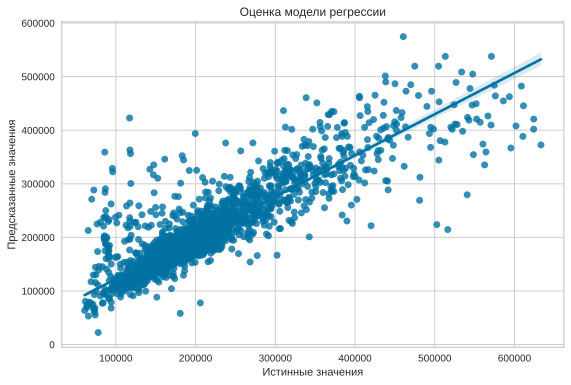

In [274]:
# Оценим эффективность модели на тестовом наборе
reg_report(y_test, gb_reg.predict(X_test))

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:197: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


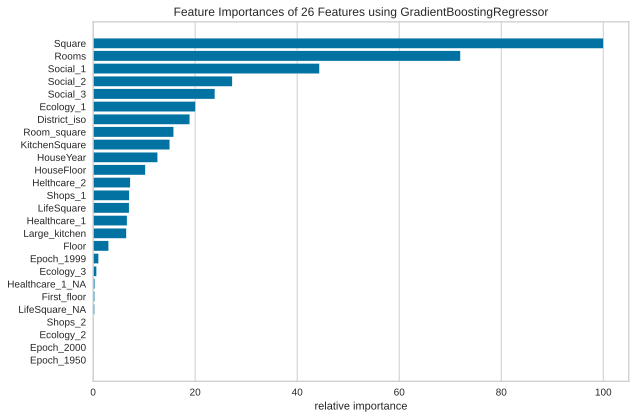

In [275]:
# Модель показала эффективность 74,1504 на тестовых данных. Что ненамного превосходит модель случайных лесов.
# Общей слабостью представленных моделей является прогнозирование цен в диапазонах от 100 000 - 200 000 - эконом сегмент
# и в диапазоне 400 000 - 600 000 верхний сегмент.
# оценим вклад каждого фактора в модель
plt.figure(figsize= (9,6))
feat_vis = FeatureImportances(gb_reg, labels= sel_cols)
feat_vis.fit(X_train, y_train)
feat_vis.poof()

Модель градиентного бустинга также считает важнейшими факторами  Площадь, Количество комнат, социальная инфраструктура.

In [276]:
# запишем модель в словарь
regressors['GBRegressor'] = gb_reg

### XGBoost - градиентный бустинг из специальной библиотеки

In [277]:
# загрузка модели
import xgboost as xgb

In [278]:
xgb_reg = xgb.XGBRegressor(objective='reg:squarederror') 

In [279]:
# параметры поиска по сетке
gb_param = {'n_estimators': (100, 600, 800)}

In [280]:
xgb_cv = GridSearchCV(estimator= xgb_reg, param_grid= gb_param, scoring = 'r2')

In [281]:
#xgb_cv.fit(X_train, y_train)

In [282]:
# XGBoost оказалась прекрасно совместима с sklearn, выведем лучшие параметры
#xgb_cv.best_params_

Налиучшие параметры оказались идентичными для аналогичного алгоритма sklearn - {'n_estimators': 600}

In [283]:
# натренируем модель с лучшим параметром
xgb_reg = xgb.XGBRegressor(n_estimators = 600, objective='reg:squarederror')
xgb_reg.fit(X_train, y_train)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=None, n_estimators=600,
             n_jobs=1, nthread=None, objective='reg:squarederror',
             random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=None, silent=None, subsample=1, verbosity=1)

Коэффициент детерминации R^2 0.7402492257648583
Средняя квадратическая ошибка MSE  2374635789.1301537


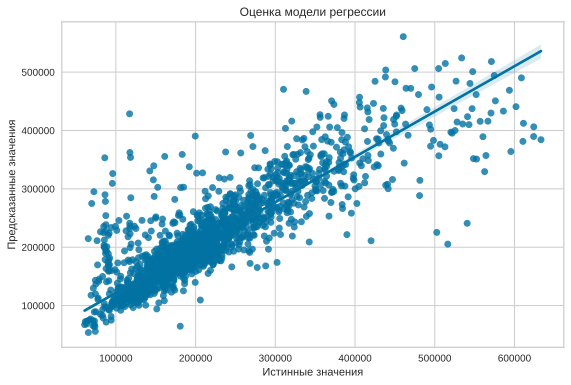

In [284]:
# выведем результат на тестовых данных
reg_report(y_test, xgb_reg.predict(X_test))

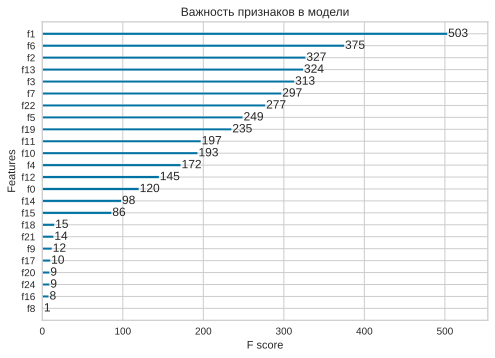

In [285]:
# у библиотеки XGBoost есть собственное средство для оценки значимости параметров модели воспользуемся им
xgb.plot_importance(xgb_reg, title = 'Важность признаков в модели')

In [286]:
# признаки f1, f6 и f2 наиболее часто втречались в деревьях решений и внесли наибольших вклад в результат, выведем из
sel_cols[1], sel_cols[6], sel_cols[2]

('Square', 'HouseYear', 'LifeSquare')

Неожиданно признак Год постройки оказался чрезвычайно важным для данной модели

In [287]:
# запишем данный регрессор в словарь
regressors['XGBoost'] = xgb_reg

### Совмещение нескольких алгоритмов машинного обучения

Результат показал незначительный рост эффективности упакованной модели попробуем реализовать другую стратегию

### Исключение малозначимых признаков из модели

In [288]:
# преобразуем тренирочный и тестовый набор данных обратно в объекты DataFrame чтобы было удобно пользоваться заголовками колонок
X_train2 = pd.DataFrame(data = X_train, columns = sel_cols)
X_train2.head()

,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,LifeSquare_NA,Healthcare_1_NA,District_iso,First_floor,Large_kitchen,Room_square,Epoch_1950,Epoch_1999,Epoch_2000
0,0.141992,0.475784,-0.189318,1.174458,-0.115825,-0.686499,0.833904,-0.620936,0.10239,0.167372,1.799708,0.102282,0.869414,-1.431503,-0.205041,0.374089,0.300853,-0.518492,1.030980,-0.208267,-0.158063,1.091412,-0.073394,-0.09259,-1.670769,1.708136
1,-1.091381,-1.572217,-0.402702,-0.957306,-0.307075,1.446078,1.704438,1.209448,0.10239,0.167372,-0.908193,-0.912516,-0.957206,0.936135,-0.876481,-0.758942,0.300853,-0.518492,1.030980,-0.110909,-0.158063,1.091412,-0.007172,-0.09259,-1.670769,1.708136
2,0.141992,0.860639,0.728451,1.174458,0.266673,1.903059,1.595621,1.551300,0.10239,0.167372,-1.154366,-1.010616,-0.957206,-0.704377,-0.876481,-1.136619,0.300853,-0.518492,-0.969951,2.684490,-0.158063,1.091412,0.265317,-0.09259,-1.670769,1.708136
3,1.375366,1.616670,1.309685,-1.168425,0.266673,0.684443,-0.417489,-0.248352,0.10239,0.167372,-1.092823,-1.048600,0.412759,1.307144,-0.876481,-0.381265,0.300853,1.928669,1.030980,-1.411633,-0.158063,-0.916244,-0.627704,-0.09259,0.598527,-0.585434
4,1.375366,1.587697,1.237648,1.174458,-0.880823,0.684443,0.779495,-1.062894,0.10239,0.167372,0.076498,0.025118,0.869414,-1.420478,-0.205041,-0.758942,0.300853,-0.518492,-0.969951,0.038471,-0.158063,1.091412,-0.644703,-0.09259,0.598527,-0.585434


In [289]:
#аналогично поступим с тестовым набором
X_test2 = pd.DataFrame(data = X_test, columns = sel_cols)
X_test2.head()

,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,LifeSquare_NA,Healthcare_1_NA,District_iso,First_floor,Large_kitchen,Room_square,Epoch_1950,Epoch_1999,Epoch_2000
0,1.375366,-0.073768,0.040399,1.434779,-0.115825,0.379789,1.541213,-0.515772,0.10239,0.167372,1.184276,1.698204,-0.500551,-1.443672,0.466399,-0.003588,0.300853,-0.518492,-0.969951,0.038471,-0.158063,1.091412,-1.619542,-0.09259,-1.670769,1.708136
1,-1.091381,2.338174,1.851435,-1.428745,-1.454571,-1.905115,-0.417489,0.211259,0.10239,0.167372,0.384214,0.378039,-0.500551,0.227714,-0.205041,-1.136619,0.300853,1.928669,-0.969951,2.270626,-0.158063,-0.916244,-0.105553,-0.09259,0.598527,-0.585434
2,0.141992,-0.891953,-0.928003,0.393497,-0.307075,-0.534172,-1.124798,-0.611099,0.10239,0.167372,0.815017,0.572146,-0.043896,1.325059,0.466399,0.751766,0.300853,-0.518492,-0.969951,0.038471,-0.158063,1.091412,-1.277142,-0.09259,0.598527,-0.585434
3,-1.091381,-0.736094,-1.035264,0.914138,1.222920,0.532116,-0.254264,0.818763,0.10239,0.167372,0.753474,1.528922,0.412759,1.491340,-0.205041,-1.136619,0.300853,-0.518492,1.030980,-2.422955,-0.158063,1.091412,1.464574,-0.09259,0.598527,-0.585434
4,-1.091381,-1.274149,-0.938475,0.914138,-0.498324,-0.077192,-0.961573,-0.529346,0.10239,0.167372,0.630387,0.842221,-0.957206,-1.155202,-0.205041,-0.003588,0.300853,-0.518492,-0.969951,1.394929,-0.158063,1.091412,0.517489,-0.09259,0.598527,-0.585434


In [290]:
# По итогам обучения моеделй с градиентным бустингом возьмем 3 наимболее значимых признака: Square, Rooms, Social_1
imp_feat = ['Square', 'Rooms', 'Social_1']

In [291]:
# обучим модель градиентного бустинга на сокращенных наборах данных
gb_imp = GradientBoostingRegressor(n_estimators= 600)

In [292]:
gb_imp.fit(X_train2[imp_feat], y_train)

GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=600,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False)

Коэффициент детерминации R^2 0.6197016695588677
Средняя квадратическая ошибка MSE  3476678861.3859744


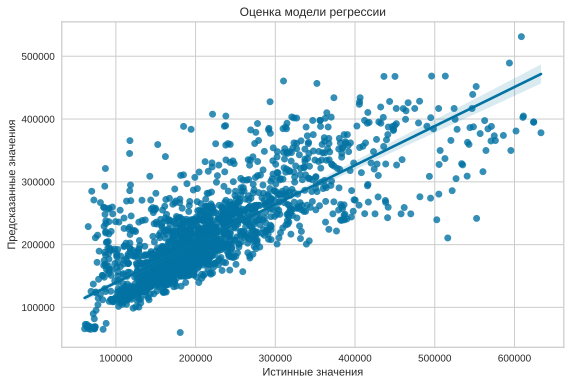

In [293]:
reg_report(y_test,
           gb_imp.predict(X_test2[imp_feat]))

Модель с самыми важными признаками потеряла часть важной информациии, что ухудьшило её качество более чем на 10%

In [294]:
sel_cols

['Rooms',
 'Square',
 'LifeSquare',
 'KitchenSquare',
 'Floor',
 'HouseFloor',
 'HouseYear',
 'Ecology_1',
 'Ecology_2',
 'Ecology_3',
 'Social_1',
 'Social_2',
 'Social_3',
 'Healthcare_1',
 'Helthcare_2',
 'Shops_1',
 'Shops_2',
 'LifeSquare_NA',
 'Healthcare_1_NA',
 'District_iso',
 'First_floor',
 'Large_kitchen',
 'Room_square',
 'Epoch_1950',
 'Epoch_1999',
 'Epoch_2000']

In [295]:
# На следующем этапе исключим 6 самых малозначимых признаков: 'Epoch_2000', 'Ecology_2', 'Epoch_1950', 'Shops_2', 'LifeSquare_NA', 'First_floor',  
imp_feat2 = ['Rooms',
 'Square',
 'LifeSquare',
 'KitchenSquare',
 'Floor',
 'HouseFloor',
 'HouseYear',
 'Ecology_1',
 'Ecology_3',
 'Social_1',
 'Social_2',
 'Social_3',
 'Healthcare_1',
 'Healthcare_1_NA',
 'Helthcare_2',
 'Shops_1',
 'District_iso',
 'Large_kitchen',
 'Room_square',
  'Epoch_1999',
 ]

In [296]:
# обучим модель с новым набором признаков
gb_imp.fit(X_train2[imp_feat2], y_train)

GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=600,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False)

Коэффициент детерминации R^2 0.744902783081829
Средняя квадратическая ошибка MSE  2332093071.8497667


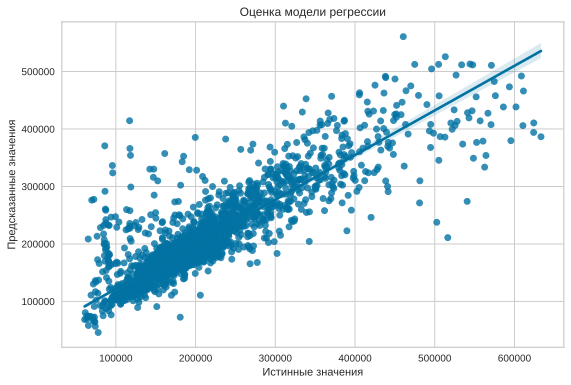

In [297]:
# результат модели с исключением малозначимых факторов
reg_report(y_test,
           gb_imp.predict(X_test2[imp_feat2]))

После исключения малозначимых факторов точность модели приблизилась к 75%

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:197: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


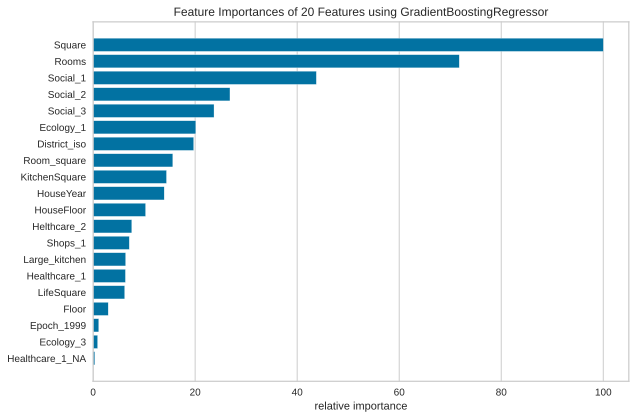

In [298]:
# Выделим 10 наиболее важных
plt.figure(figsize= (9,6))
feat_vis = FeatureImportances(gb_imp, labels = imp_feat2)
feat_vis.fit(X_train2[imp_feat2], y_train)
feat_vis.poof()

In [299]:
feat_vis.features_

array(['Healthcare_1_NA', 'Ecology_3', 'Epoch_1999', 'Floor',
       'LifeSquare', 'Healthcare_1', 'Large_kitchen', 'Shops_1',
       'Helthcare_2', 'HouseFloor', 'HouseYear', 'KitchenSquare',
       'Room_square', 'District_iso', 'Ecology_1', 'Social_3', 'Social_2',
       'Social_1', 'Rooms', 'Square'], dtype='<U15')

In [300]:
# наиболее важные
feat_imp2 = list(feat_vis.features_)
feat_imp2.reverse()
feat_imp2

['Square',
 'Rooms',
 'Social_1',
 'Social_2',
 'Social_3',
 'Ecology_1',
 'District_iso',
 'Room_square',
 'KitchenSquare',
 'HouseYear',
 'HouseFloor',
 'Helthcare_2',
 'Shops_1',
 'Large_kitchen',
 'Healthcare_1',
 'LifeSquare',
 'Floor',
 'Epoch_1999',
 'Ecology_3',
 'Healthcare_1_NA']

# 5. Применение полученной модели

In [301]:
# применим полученную модель машинного обучения для прогнозирования данных из контрольного набора и выода результатов
# для систематизаци процесса создадим соответсвующий класс

class PriceForecast:
    def __init__(self, estimator):
        """
        estimator - выбранная модель машинного обучения, можно использовать 
        зараенее обученную модель. Или даинамически созданную, например
        estimator = LinearRegression()

        """
        self.estimator = estimator
        return

    def fit(self, X_train, y_train):
        """
        Осуществляет обучение модели self.estimator на тренировочном наборе данных
        X_train, y_train. 
        """
        self.estimator.fit(X_train, y_train)
        return

    def predict(self, X_data):
        return self.estimator.predict(X_data)

In [302]:
price_pred = PriceForecast(gb_imp) # инициализируем натренированной моделью

In [303]:
# Преобразуем контрольный набор данных снова в объект DataFrame
X_val = pd.DataFrame(data = X_val, index = y_val.index, columns = sel_cols)
X_val.head()

,Rooms,Square,LifeSquare,KitchenSquare,Floor,HouseFloor,HouseYear,Ecology_1,Ecology_2,Ecology_3,Social_1,Social_2,Social_3,Healthcare_1,Helthcare_2,Shops_1,Shops_2,LifeSquare_NA,Healthcare_1_NA,District_iso,First_floor,Large_kitchen,Room_square,Epoch_1950,Epoch_1999,Epoch_2000
Id,,,,,,,,,,,,,,,,,,,,,,,,,,
4567,-1.091381,-1.154185,-1.178961,-0.127143,-0.498324,-0.534172,-0.798348,-0.674617,0.10239,0.167372,0.014955,-0.168989,-0.957206,0.014623,-0.205041,-0.758942,0.300853,-0.518492,-0.969951,-0.349114,-0.158063,-0.916244,0.728649,-0.09259,0.598527,-0.585434
5925,-1.091381,-0.764777,-0.478454,1.174458,-0.115825,0.684443,1.758846,-0.287276,0.10239,0.167372,-1.338996,-1.290262,-0.500551,0.905120,-0.876481,-1.136619,-3.323882,-0.518492,1.030980,-1.111288,-0.158063,1.091412,1.414086,-0.09259,-1.670769,1.708136
960,0.141992,0.405580,0.400323,0.914138,2.179167,0.989097,-0.417489,1.209448,0.10239,0.167372,-0.908193,-0.912516,-0.957206,-0.035149,-0.876481,-0.758942,0.300853,1.928669,1.030980,-0.110909,-0.158063,1.091412,-0.135181,-0.09259,0.598527,-0.585434
3848,1.375366,-0.271516,-0.016306,0.133177,-1.072072,-1.600461,-1.070390,-0.911625,0.10239,0.167372,-1.338996,-1.336321,-0.957206,1.128681,-0.876481,-1.136619,0.300853,-0.518492,1.030980,-1.411633,-0.158063,-0.916244,-1.735568,-0.09259,0.598527,-0.585434
746,-1.091381,0.017527,0.108949,-1.168425,0.075424,0.684443,-0.417489,2.263683,0.10239,0.167372,0.691930,0.829061,0.869414,-0.052058,-0.876481,1.129443,0.300853,1.928669,-0.969951,0.038149,-0.158063,-0.916244,-0.137531,-0.09259,0.598527,-0.585434


In [304]:
# выполним предсказание с помощью полученной модели (сразу преобразуем результат в датафрем)
y_pred = pd.DataFrame( data = {'Price': price_pred.predict(X_val[imp_feat2])}, index = X_val.index)
y_pred.head()

,Price
Id,
4567,164005.634629
5925,118659.645680
960,149796.299962
3848,112502.655257
746,210989.232187


In [305]:
# сохраним результы в файл
sub_name = 'ssmirnov_submission.csv'
#y_pred.to_csv(sub_name)

In [306]:
# модель градиентного бустинга со всеми признаками
price_pred2 = PriceForecast(xgb_reg)

In [307]:
y_pred2 = pd.DataFrame( data = {'Price': price_pred2.predict(X_val.values)}, index = X_val.index)
y_pred2.head()

,Price
Id,
4567,167785.328125
5925,119318.164062
960,149728.343750
3848,107230.585938
746,211952.203125


In [308]:
# сохраним результы в файл
sub_name = 'ssmirnov_submission2.csv'
#y_pred2.to_csv(sub_name)

# Доработка полученной модели и набора данных



In [309]:
# имея сведения о наиболее важных признаках, попробуем создать дополнетельные признаки, повышающие качество прогноза
# введем дополнительные колличественные признаки, чтобы модель "внимательнее" относилась к малозначимым признакам
X_train2['Healtchare_1_per_Square'] = X_train2.Healthcare_1 / X_train2.Square 
X_train2['Shops_1_per_Square']      = X_train2.Shops_1 / X_train2.Square
X_train2['House_floor_per_Square']  = X_train2.HouseFloor / X_train2.Square
X_train2['HouseYear_per_Square']    = X_train2.HouseYear / X_train2.Square


In [310]:
# Аналогично для тестового и контрльного наборов
X_test2['Healtchare_1_per_Square'] = X_test2.Healthcare_1 / X_test2.Square  # Тестовый
X_test2['Shops_1_per_Square']      = X_test2.Shops_1 / X_test2.Square
X_test2['House_floor_per_Square']  = X_test2.HouseFloor / X_test2.Square
X_test2['HouseYear_per_Square']    = X_test2.HouseYear / X_test2.Square

X_val['Healtchare_1_per_Square'] = X_val.Healthcare_1 / X_val.Square  # Контрольный
X_val['Shops_1_per_Square']      = X_val.Shops_1 / X_val.Square
X_val['House_floor_per_Square']  = X_val.HouseFloor / X_val.Square
X_val['HouseYear_per_Square']    = X_val.HouseYear / X_val.Square


In [311]:
# Обучим модель градиентного буcтинга на полученных датасетах

new_cols = list([*imp_feat2, 'Healtchare_1_per_Square','Shops_1_per_Square', 'House_floor_per_Square', 'HouseYear_per_Square'])
print(new_cols)

['Rooms', 'Square', 'LifeSquare', 'KitchenSquare', 'Floor', 'HouseFloor', 'HouseYear', 'Ecology_1', 'Ecology_3', 'Social_1', 'Social_2', 'Social_3', 'Healthcare_1', 'Healthcare_1_NA', 'Helthcare_2', 'Shops_1', 'District_iso', 'Large_kitchen', 'Room_square', 'Epoch_1999', 'Healtchare_1_per_Square', 'Shops_1_per_Square', 'House_floor_per_Square', 'HouseYear_per_Square']


In [312]:
gbr2 = xgb.XGBRegressor(n_estimators = 480, objective= 'reg:squarederror')

In [313]:
gbr2.fit(X_train2[new_cols], y_train)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=None, n_estimators=480,
             n_jobs=1, nthread=None, objective='reg:squarederror',
             random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=None, silent=None, subsample=1, verbosity=1)

Коэффициент детерминации R^2 0.7435266634806024
Средняя квадратическая ошибка MSE  2344673526.575334


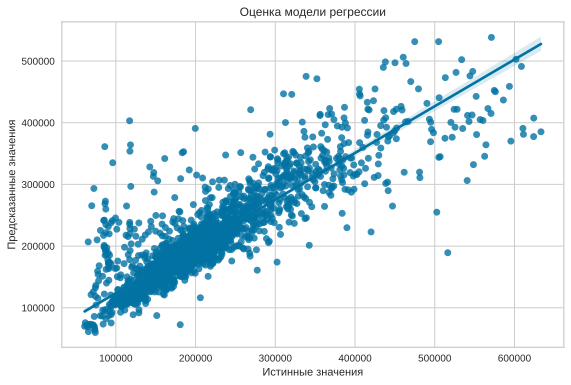

In [314]:
# проверим результативность
reg_report(y_test, gbr2.predict(X_test2[new_cols]))

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:197: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


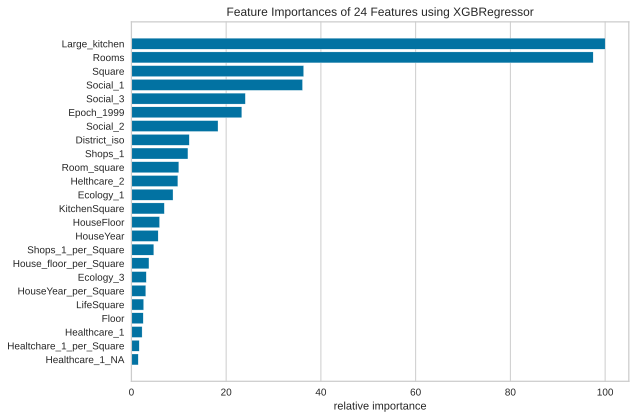

In [315]:
plt.figure(figsize= (9,6))
feat_vis = FeatureImportances(gbr2, labels =new_cols)
feat_vis.fit(X_train2[new_cols], y_train)
feat_vis.poof()

In [316]:
# лучшая модель с новыми признаками показала результ 74,35
price_pred3 = PriceForecast(gbr2)
y_pred3 = pd.DataFrame( data = {'Price': price_pred3.predict(X_val[new_cols])}, index = X_val.index)
y_pred3.head()

,Price
Id,
4567,171238.593750
5925,117200.218750
960,159810.062500
3848,123486.398438
746,188735.281250


In [317]:
# сохраним результы в файл
sub_name = 'ssmirnov_submission3.csv'
y_pred3.to_csv(sub_name)

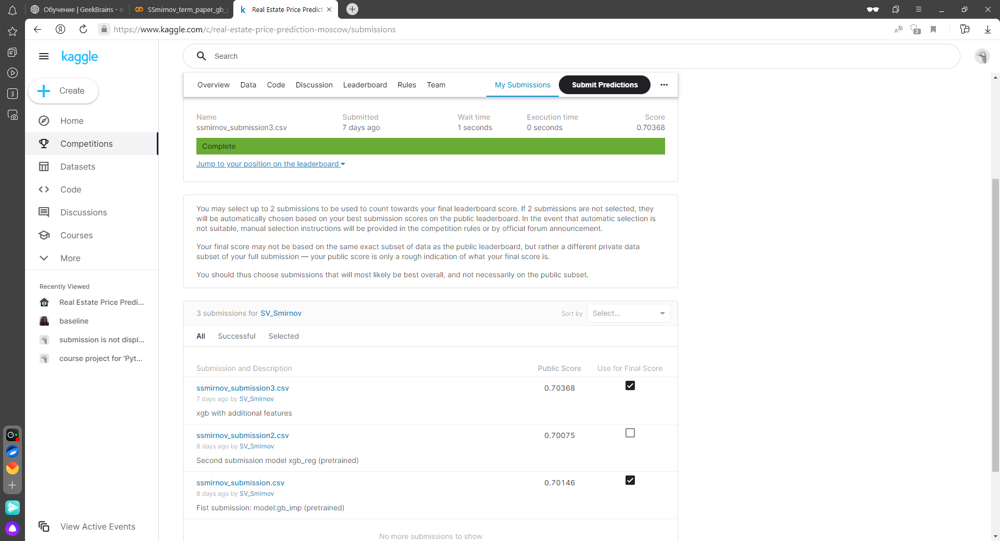